# <center> Introduction

## Задача:  

Существуют нечестные отели, которые накручивают себе рейтинг. Одним из способов нахождения таких отелей является построение модели, которая предсказывает рейтинг отеля. Если предсказания модели сильно отличаются от фактического результата, то, возможно, отель играет нечестно, и его стоит проверить. 

_Условия соревнования:_
- Тестовая выборка представлена в LeaderBoard целиком (hotels_test.csv).
- Файл представления (сабмишен) для каждого **id** отеля в наборе тестовых данных должен быть предсказан рейтинг отеля переменная **reviewer_score**. Файл должен содержать заголовок и иметь следующий формат: ``` reviewer_score,id 1,1 ``` (submission.csv)

_Метрика:_  

Метрикой в данном соревновании является __MAPE - средняя абсолютная ошибка в процентах (mean absolute percentage error).__ MAPE выражает ошибку модели как процентное отклонение прогнозов модели от фактических значений целевой переменной.  

Причины выбора MAPE:
- позволяет оценить точность модели в процентах (от целевой переменной)
- позволяет сравнивать точность разных моделей на разных наборах данных в процентном выражении (удобно для выбора наилучшей модели из нескольких альтернатив)
- полезна в задачах, где важно измерить точность модели в процентах (в данном случае оценить насколько рейтинг отклоняеться от факта)

## Данные:  

_Данные у нас представленны тремя файлами:_  
- hotels_train.csv - набор данных для обучения
- hotels_test.csv - набор данных для оценки качества
- submission.csv - файл сабмишна в нужном формате

_Описание признаков:_
- hotel_address - адрес отеля
- review_date - дата, когда рецензент разместил соответствующий отзыв.
- average_score - средний балл отеля, рассчитанный на основе последнего комментария за последний год
- hotel_name - название отеля
- reviewer_nationality - национальность рецензента
- negative_review - отрицательный отзыв, который рецензент дал отелю.
- review_total_negative_word_counts - общее количество слов в отрицательном отзыв
- positive_review - положительный отзыв, который рецензент дал отелю
- review_total_positive_word_counts - общее количество слов в положительном отзыве
- reviewer_score - оценка, которую рецензент поставил отелю на основе своего опыта
- total_number_of_reviews_reviewer_has_given - количество отзывов, которые рецензенты дали в прошлом
- total_number_of_reviews - общее количество действительных отзывов об отеле
- tags - теги, которые рецензент дал отелю.
- days_since_review - продолжительность между датой проверки и датой очистки
- additional_number_of_scoring - есть также некоторые гости, которые просто поставили оценку сервису, а не оставили отзыв. Это число указывает, сколько там действительных оценок без проверки.
- lat - широта отеля
- lng - долгота отеля

## Imports
Import libraries and write settings below.

In [113]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
from geopy.geocoders import Nominatim as Nominatim_geopy  # work to geo service
from tqdm import tqdm, tqdm_notebook
from geopy.distance import geodesic
from OSMPythonTools.nominatim import Nominatim as Nominatim_OSM
from OSMPythonTools.overpass import overpassQueryBuilder, Overpass
from afinn import Afinn
import re
import nltk
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
from textblob import TextBlob, Blobber

# instantiate
tqdm.pandas()


# Visualizations
import matplotlib.pyplot as plt
import seaborn as sns 
import plotly.express as px
import plotly.graph_objects as go
%matplotlib inline

# Modeling
# подготовка датасета для модели
from sklearn.model_selection import train_test_split
# инструмент для создания и обучения модели
from sklearn.ensemble import RandomForestRegressor 
from sklearn import metrics # инструменты для оценки точности модели
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import ENGLISH_STOP_WORDS

# file path of kaggle
import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))
        
pd.set_option('display.max_colwidth', 100)

In [45]:
# Here we setup the constants
RANDOM_SEED = 42
# зафиксируем версию пакетов, чтобы эксперименты были воспроизводимы:
!pip freeze > requirements.txt
# Подгрузим наши данные из соревнования
#DATA_DIR = '/kaggle/input/sf-booking/'
df_train = pd.read_csv('data/hotels_train.csv') # датасет для обучения
df_test = pd.read_csv('data/hotels_test.csv') # датасет для предсказания
sample_submission = pd.read_csv('data/submission.csv') # самбмишн

In [ ]:
# функций

def column_info(column)-> str:
    """Функция принимает серию из датафрейма и возврашает 
    обратно информацию о серий

    Args:
        column (Series): Принимает серию из датафрейма.

    Returns:
        str: Возврашает данные полученные после обработки серий 
    """
    print('Количество NaN в столбце:', (column.isnull()).sum(), '\n******')
    print('Соотношение непустых/пустых значений в столбце:' '\n',
          column.isnull().value_counts(normalize=True)*100, '\n******')
    print('Уникальные значения:', column.nunique(), '\n******')
    print('Количество повторений значения:' '\n', column.value_counts(
                                                                ), '\n******')
    print(column.sample(5), '\n----------------------------------------')
    return

def tokenisation(review: str) -> list:
    """Функция принимает строку и преобразует ее в токены

    Args:
        review (str): Принимает строку и преобразует ее в список токенов

    Returns:
        list: Возврашает список слов/токенов из строки
    """
    # будем искать 1 и более символов не текстовых
    tokens = re.split('\W+', review)
    return tokens

# stemming
ps = nltk.PorterStemmer()
def stemming(review_tokens: list) -> list:
    """Функция принимает список слов и подвергает их стеммингу:
    процессу нахождения основы слова для заданного исходного слова

    Args:
        review_tokens (list): список слов/токенов

    Returns:
        list: список слов/токенов подвергшихся стеммингу
    """
    tokens = [ps.stem(token) for token in review_tokens]
    return tokens

wn = nltk.WordNetLemmatizer()

def lemmatising(review_tokens: list)-> list:
    """Функция принимает список слов и подвергает их лемматизаций:
     процесс приведения словоформы к лемме — её нормальной форме

    Args:
        review_tokens (list): список слов/токенов

    Returns:
        list: список слов/токенов подвергшихся лемматизаций
    """
    tokens = [wn.lemmatize(token) for token in review_tokens]
    return tokens

def strings(review_tokens: list)-> str:
    """Функция преобразует слова/токены из списка в строку

    Args:
        review_tokens (list): список слов/токенов

    Returns:
        str: список преобразованный в строку
    """
    text = ' '.join(review_tokens)
    return text

afinn = Afinn()
def afinn_analysis(df, col, prefix, afinn)-> DataFrame:
    """Функция для анализа полярностей отзывов на основе Afinn()

    Args:
        df (_type_): Датафрейм
        col (_type_): Параметр/столбец
        prefix (_type_): префикс для нового столбца
        afinn (_type_): анализатор полярности отзыва

    Returns:
        DataFrame: Возврашает датафрейм с новым параметром/столбцом 
    """
    df['afinn_'+prefix+'_score'] = df[col].apply(lambda x: afinn.score(x))
    return df

vader = SentimentIntensityAnalyzer()
def vader_analysis(df, col, prefix, sia) -> DataFrame:
    """Функция для анализа полярностей отзывов 
    на основе SentimentIntensityAnalyzer()

    Args:
        df (_type_): Датафрейм
        col (_type_): Параметр/столбец
        prefix (_type_): префикс для нового столбца
        sia (_type_): анализатор полярности отзыва

    Returns:
        DataFrame: Возврашает Датафрейм с новым парамтером/столбцом
    """
    
    df['polarity_scores'] = df[col].apply(sia.polarity_scores)
    
    df['vader_'+prefix+'_neg']      = df['polarity_scores'].apply(lambda x: x['neg'])
    df['vader_'+prefix+'_neu']      = df['polarity_scores'].apply(lambda x: x['neu'])
    df['vader_'+prefix+'_pos']      = df['polarity_scores'].apply(lambda x: x['pos'])
    df['vader_'+prefix+'_compound'] = df['polarity_scores'].apply(lambda x: x['compound'])

    df.drop('polarity_scores', axis=1, inplace=True)
    
    return df


textblob = TextBlob
def textblob_analysis(df, col, prefix, textblob)-> DataFrame:
    """Функция для анализа полярностей отзывов 
    на основе TextBlob

    Args:
        df (_type_): Датафрейм
        col (_type_): Параметр/столбец
        prefix (_type_): префикс для нового столбца
        textblob (_type_): анализатор полярности отзыва

    Returns:
        DataFrame: Возврашает Датафрейм с новым парамтером/столбцом
    """
    df['tb_'+prefix+'_polarity']     = df[col].apply(lambda x: textblob(x).sentiment.polarity)
    df['tb_'+prefix+'_subjectivity'] = df[col].apply(lambda x: textblob(x).sentiment.subjectivity)
    
    return df


def night_in_hotel(ls: list)-> int:
    """Функция для подсчета количества ночей указанных в тэгах

    Args:
        ls (list): Принимаем список тэгов

    Returns:
        int: Возврашаем количестов ночей, либо 0 если не указанно в тэгах
    """
    ls = str(ls)
    match = re.findall(r'Stayed\s([0-9]+)\snight', ls)
    if match:
        return int(match[0])
    else:
        return 0


# Функция для построенния корреляционной диаграммы, так как у нас в данных 
# есть выбросы, то мы будем использовать по умолчанию корреляцию spearman
def corr_heatmap(col_list, title, method='spearman', corr_scoping=0.0):
    """Функция для построенния корреляционной диаграммы

    Args:
        col_list (list): Принимает список параметров/столбцов
        title (str): Название графика
        method (str, optional): Выбор метода. Defaults to 'spearman'.
        corr_scoping (float, optional): Выборка для отображения данных. Defaults to 0.0.
    """
    fig, ax = plt.subplots(figsize=(16, 9))
    corr = hotels[col_list].corr(method=method).abs()
    mask = np.triu(np.ones_like(corr, dtype=bool))
    sns.heatmap(corr[corr.abs() > corr_scoping], 
                annot=True,
                fmt='.2g',
                annot_kws={"fontsize":10}, 
                linewidths=.1, 
                linecolor='black',
                ax=ax, 
                mask=mask, 
                cmap='PRGn',
                vmin = -1, 
                vmax = 1, 
                center = 0,
                )
    ax.set_title(title, fontsize=18)
    plt.show()

# <center> Analysis

In [3]:
# посмотрим train
display(df_train.head())

,hotel_address,additional_number_of_scoring,review_date,average_score,hotel_name,reviewer_nationality,negative_review,review_total_negative_word_counts,total_number_of_reviews,positive_review,review_total_positive_word_counts,total_number_of_reviews_reviewer_has_given,reviewer_score,tags,days_since_review,lat,lng
0,Stratton Street Mayfair Westminster Borough London W1J 8LT United Kingdom,581,2/19/2016,8.4,The May Fair Hotel,United Kingdom,Leaving,3,1994,Staff were amazing,4,7,10.0,"[' Leisure trip ', ' Couple ', ' Studio Suite ', ' Stayed 2 nights ', ' Submitted from a mobile ...",531 day,51.507894,-0.143671
1,130 134 Southampton Row Camden London WC1B 5AF United Kingdom,299,1/12/2017,8.3,Mercure London Bloomsbury Hotel,United Kingdom,poor breakfast,3,1361,location,2,14,6.3,"[' Business trip ', ' Couple ', ' Standard Double Room ', ' Stayed 1 night ']",203 day,51.521009,-0.123097
2,151 bis Rue de Rennes 6th arr 75006 Paris France,32,10/18/2016,8.9,Legend Saint Germain by Elegancia,China,No kettle in room,6,406,No Positive,0,14,7.5,"[' Leisure trip ', ' Solo traveler ', ' Modern Double Room Echo ', ' Stayed 3 nights ', ' Submit...",289 day,48.845377,2.325643
3,216 Avenue Jean Jaures 19th arr 75019 Paris France,34,9/22/2015,7.5,Mercure Paris 19 Philharmonie La Villette,United Kingdom,No Negative,0,607,Friendly staff quiet comfortable room spotlessly clean excellent location,11,8,10.0,"[' Leisure trip ', ' Solo traveler ', ' Standard Room with 1 Double Bed ', ' Stayed 1 night ']",681 day,48.888697,2.394540
4,Molenwerf 1 1014 AG Amsterdam Netherlands,914,3/5/2016,8.5,Golden Tulip Amsterdam West,Poland,Torn sheets,4,7586,The staff was very friendly and helpful Breakfasts were just extraordinary Room was clean quiet...,20,10,9.6,"[' Business trip ', ' Couple ', ' Standard Double or Twin Room ', ' Stayed 6 nights ']",516 day,52.385601,4.847060


In [4]:
# Информация об датасете
display(df_train.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 386803 entries, 0 to 386802
Data columns (total 17 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   hotel_address                               386803 non-null  object 
 1   additional_number_of_scoring                386803 non-null  int64  
 2   review_date                                 386803 non-null  object 
 3   average_score                               386803 non-null  float64
 4   hotel_name                                  386803 non-null  object 
 5   reviewer_nationality                        386803 non-null  object 
 6   negative_review                             386803 non-null  object 
 7   review_total_negative_word_counts           386803 non-null  int64  
 8   total_number_of_reviews                     386803 non-null  int64  
 9   positive_review                             386803 non-null  object 
 

None

In [5]:
# Посмотрим стат. данные числовые
display(df_train.describe())

,additional_number_of_scoring,average_score,review_total_negative_word_counts,total_number_of_reviews,review_total_positive_word_counts,total_number_of_reviews_reviewer_has_given,reviewer_score,lat,lng
count,386803.000000,386803.000000,386803.000000,386803.000000,386803.000000,386803.00000,386803.000000,384355.000000,384355.000000
mean,498.246536,8.397231,18.538988,2743.992042,17.776985,7.17725,8.396906,49.443522,2.823402
std,500.258012,0.547881,29.703369,2316.457018,21.726141,11.05442,1.636090,3.466936,4.579043
min,1.000000,5.200000,0.000000,43.000000,0.000000,1.00000,2.500000,41.328376,-0.369758
25%,169.000000,8.100000,2.000000,1161.000000,5.000000,1.00000,7.500000,48.214662,-0.143649
50%,342.000000,8.400000,9.000000,2134.000000,11.000000,3.00000,8.800000,51.499981,-0.000250
75%,660.000000,8.800000,23.000000,3613.000000,22.000000,8.00000,9.600000,51.516288,4.834443
max,2682.000000,9.800000,408.000000,16670.000000,395.000000,355.00000,10.000000,52.400181,16.429233


In [6]:
# Посмотрим стат. данные категориальные
display(df_train.describe(include='object'))

,hotel_address,review_date,hotel_name,reviewer_nationality,negative_review,positive_review,tags,days_since_review
count,386803,386803,386803,386803,386803,386803,386803,386803
unique,1493,731,1492,225,248828,311737,47135,731
top,163 Marsh Wall Docklands Tower Hamlets London E14 9SJ United Kingdom,8/2/2017,Britannia International Hotel Canary Wharf,United Kingdom,No Negative,No Positive,"[' Leisure trip ', ' Couple ', ' Double Room ', ' Stayed 1 night ', ' Submitted from a mobile de...",1 days
freq,3587,1911,3587,184033,95907,26885,3853,1911


In [7]:
# Размеры представленных данных 
display(df_train.shape)

(386803, 17)

In [8]:
# Оценим пропуски в процентном соотношение
cols_null_percent = df_train.isnull().mean() * 100
cols_with_null = cols_null_percent[cols_null_percent>0].sort_values(
                                                            ascending=False)
display(cols_with_null)

lat    0.63288
lng    0.63288
dtype: float64

In [9]:
# посмотрим дубликаты
# считываем столбцы (параметры)
dupl_columns = list(df_train.columns)
# применяем считынанные параметры к функций поиска дубликатов (создаем маску поиска)
mask = df_train.duplicated(subset=dupl_columns)
# Ищем дубликаты
train_duplicates = df_train[mask]
print(f'Число найденных дубликатов: {train_duplicates.shape[0]}')

Число найденных дубликатов: 307


In [10]:
# попробуем определить неинформативные признаки, установим порог 0.95 для уникальных, 
# либо повторяющихся данных в столбцах
low_information_cols = [] 
#цикл по всем столбцам
for col in df_train.columns:
    #наибольшая относительная частота в признаке
    top_freq = df_train[col].value_counts(normalize=True).max()
    #доля уникальных значений от размера признака
    nunique_ratio = df_train[col].nunique() / df_train[col].count()
    # сравниваем наибольшую частоту с порогом
    if top_freq > 0.95:
        low_information_cols.append(col)
        print(f'{col}: {round(top_freq*100, 2)}% одинаковых значений')
    # сравниваем долю уникальных значений с порогом
    if nunique_ratio > 0.95:
        low_information_cols.append(col)
        print(f'{col}: {round(nunique_ratio*100, 2)}% уникальных значений')

<hr style="border-style: dashed;">

__Вывод:__  
- размер датасета 386803 строки, 17 столбцов (параметров)
- числовых данных 9 столбцов: additional_number_of_scoring, average_score, review_total_negative_word_counts, total_number_of_reviews, review_total_positive_word_counts, total_number_of_reviews_reviewer_has_given, reviewer_score (целевая/target переменная), lat, lng
- категориальные (object) данные 8 столбцов: hotel_address, review_date, hotel_name, reviewer_nationality, negative_review, positive_review, tags, days_since_review
- есть пропуски в числовых столбцах (lat, lng), менне 1%
- есть дубликаты (307) 

<hr style="border-style: dashed;">

In [11]:
# Посмотрим тест и сабмишен
display(df_test.head())
display(df_test.info())
display(df_test.shape)
# Оценим пропуски в процентном соотношение
cols_null_percent = df_test.isnull().mean() * 100
cols_with_null = cols_null_percent[cols_null_percent>0].sort_values(
                                                            ascending=False)
print(f'Найденные пропуски:')
display(cols_with_null)
# посмотрим дубликаты
# считываем столбцы (параметры)
dupl_columns = list(df_test.columns)
# применяем считынанные параметры к функций поиска дубликатов (создаем маску поиска)
mask = df_test.duplicated(subset=dupl_columns)
# Ищем дубликаты
train_duplicates = df_test[mask]
print(f'Число найденных дубликатов: {train_duplicates.shape[0]}')

print('------------------------\n')
display(sample_submission.head())
display(sample_submission.info())
display(sample_submission.shape)

,hotel_address,additional_number_of_scoring,review_date,average_score,hotel_name,reviewer_nationality,negative_review,review_total_negative_word_counts,total_number_of_reviews,positive_review,review_total_positive_word_counts,total_number_of_reviews_reviewer_has_given,tags,days_since_review,lat,lng
0,Via Senigallia 6 20161 Milan Italy,904,7/21/2017,8.1,Hotel Da Vinci,United Kingdom,Would have appreciated a shop in the hotel that sold drinking water etc but not necessity Would...,52,16670,Hotel was great clean friendly staff free breakfast every morning with good selection good wifi...,62,1,"[' Leisure trip ', ' Couple ', ' Double Room ', ' Stayed 2 nights ']",13 days,45.533137,9.171102
1,Arlandaweg 10 Westpoort 1043 EW Amsterdam Netherlands,612,12/12/2016,8.6,Urban Lodge Hotel,Belgium,No tissue paper box was present at the room,10,5018,No Positive,0,7,"[' Leisure trip ', ' Group ', ' Triple Room ', ' Stayed 1 night ']",234 day,52.385649,4.834443
2,Mallorca 251 Eixample 08008 Barcelona Spain,46,11/26/2015,8.3,Alexandra Barcelona A DoubleTree by Hilton,Sweden,Pillows,3,351,Nice welcoming and service,5,15,"[' Business trip ', ' Solo traveler ', ' Twin Room ', ' Stayed 1 night ', ' Submitted from a mob...",616 day,41.393192,2.161520
3,Piazza Della Repubblica 17 Central Station 20124 Milan Italy,241,10/17/2015,9.1,Hotel Principe Di Savoia,United States of America,No Negative,0,1543,Everything including the nice upgrade The Hotel has been revamped and what a surprise Love ever...,27,9,"[' Leisure trip ', ' Couple ', ' Ambassador Junior Suite ', ' Stayed 1 night ']",656 day,45.479888,9.196298
4,Singel 303 309 Amsterdam City Center 1012 WJ Amsterdam Netherlands,834,5/16/2016,9.1,Hotel Esther a,United Kingdom,No Negative,0,4687,Lovely hotel v welcoming staff,7,2,"[' Business trip ', ' Solo traveler ', ' Classic Double or Twin Room ', ' Stayed 2 nights ', ' S...",444 day,52.370545,4.888644


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 128935 entries, 0 to 128934
Data columns (total 16 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   hotel_address                               128935 non-null  object 
 1   additional_number_of_scoring                128935 non-null  int64  
 2   review_date                                 128935 non-null  object 
 3   average_score                               128935 non-null  float64
 4   hotel_name                                  128935 non-null  object 
 5   reviewer_nationality                        128935 non-null  object 
 6   negative_review                             128935 non-null  object 
 7   review_total_negative_word_counts           128935 non-null  int64  
 8   total_number_of_reviews                     128935 non-null  int64  
 9   positive_review                             128935 non-null  object 
 

None

(128935, 16)

Найденные пропуски:


lat    0.635979
lng    0.635979
dtype: float64

Число найденных дубликатов: 29
------------------------



,reviewer_score,id
0,1,488440
1,10,274649
2,3,374688
3,10,404352
4,9,451596


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 128935 entries, 0 to 128934
Data columns (total 2 columns):
 #   Column          Non-Null Count   Dtype
---  ------          --------------   -----
 0   reviewer_score  128935 non-null  int64
 1   id              128935 non-null  int64
dtypes: int64(2)
memory usage: 2.0 MB


None

(128935, 2)

(386803, 90)

<hr style="border-style: dashed;">

__Вывод:__  
- размер датасета для теста 128935 строк, 16 столбцов (параметров), размер датасета для сабмишена 128935 строк, 2 столбца (параметра)
- для теста данные: числовые 8 столбцов, категориальные (object) 8 столбцов, для сабмишена данные: 2 числовых столбца
- в тесте есть пропуски в числовых столбцах (lat, lng), менне 1%
- есть дубликаты в тесте (29) 

<hr style="border-style: dashed;">

## <center>1. Исследование и анализ данных 

__Взглянем поближе на наши данные__

In [13]:
# hotel_address
column_info(df_train['hotel_address'])

Количество NaN в столбце: 0 
******
Соотношение непустых/пустых значений в столбце:
 False    100.0
Name: hotel_address, dtype: float64 
******
Уникальные значения: 1493 
******
Количество повторений значения:
 163 Marsh Wall Docklands Tower Hamlets London E14 9SJ United Kingdom              3587
372 Strand Westminster Borough London WC2R 0JJ United Kingdom                     3206
Westminster Bridge Road Lambeth London SE1 7UT United Kingdom                     3095
Scarsdale Place Kensington Kensington and Chelsea London W8 5SY United Kingdom    2688
7 Pepys Street City of London London EC3N 4AF United Kingdom                      2379
                                                                                  ... 
Via Palmanova 153 20132 Milan Italy                                                  7
40 Rue Rene Boulanger 10th arr 75010 Paris France                                    7
Via M Buonarroti 13 Fiera Milano City 20149 Milan Italy                              6
Johann

In [14]:
# additional_number_of_scoring
column_info(df_train['additional_number_of_scoring'])

Количество NaN в столбце: 0 
******
Соотношение непустых/пустых значений в столбце:
 False    100.0
Name: additional_number_of_scoring, dtype: float64 
******
Уникальные значения: 480 
******
Количество повторений значения:
 2682    3587
2288    3206
2623    3095
1831    2688
1936    2379
        ... 
8         38
5         33
17        18
1         10
4         10
Name: additional_number_of_scoring, Length: 480, dtype: int64 
******
143577     353
176379    1485
261875      20
382686     253
125978     918
Name: additional_number_of_scoring, dtype: int64 
----------------------------------------


In [15]:
# review_date
column_info(df_train['review_date'])

Количество NaN в столбце: 0 
******
Соотношение непустых/пустых значений в столбце:
 False    100.0
Name: review_date, dtype: float64 
******
Уникальные значения: 731 
******
Количество повторений значения:
 8/2/2017      1911
9/15/2016     1738
4/5/2017      1702
8/30/2016     1462
2/16/2016     1451
              ... 
4/3/2017       154
12/3/2016      154
11/27/2015     146
4/1/2017       127
4/2/2017       111
Name: review_date, Length: 731, dtype: int64 
******
66630      3/29/2017
255419     9/16/2016
146646      2/3/2017
187052     2/14/2017
271224    10/30/2016
Name: review_date, dtype: object 
----------------------------------------


In [16]:
# average_score
column_info(df_train['average_score'])

Количество NaN в столбце: 0 
******
Соотношение непустых/пустых значений в столбце:
 False    100.0
Name: average_score, dtype: float64 
******
Уникальные значения: 34 
******
Количество повторений значения:
 8.4    30929
8.5    28531
8.1    28529
8.7    28199
8.6    27713
8.2    26174
8.3    24731
8.8    23178
8.9    21446
8.0    16797
9.1    16028
9.0    15704
7.8    14994
7.9    11453
7.5    10281
9.2     9585
9.3     9519
7.7     8786
9.4     7042
7.1     5070
7.6     4989
7.4     4823
7.3     3016
7.0     2941
6.9     1283
6.8      991
9.5      920
6.4      868
6.7      719
9.6      694
7.2      509
6.6      299
5.2       44
9.8       18
Name: average_score, dtype: int64 
******
335163    9.0
168283    7.4
256502    8.8
95313     8.3
94850     8.8
Name: average_score, dtype: float64 
----------------------------------------


In [17]:
# hotel_name
column_info(df_train['hotel_name'])

Количество NaN в столбце: 0 
******
Соотношение непустых/пустых значений в столбце:
 False    100.0
Name: hotel_name, dtype: float64 
******
Уникальные значения: 1492 
******
Количество повторений значения:
 Britannia International Hotel Canary Wharf           3587
Strand Palace Hotel                                  3206
Park Plaza Westminster Bridge London                 3095
Copthorne Tara Hotel London Kensington               2688
DoubleTree by Hilton Hotel London Tower of London    2379
                                                     ... 
Ibis Styles Milano Palmanova                            7
Renaissance Paris Republique Hotel Spa                  7
Hotel Wagner                                            6
Hotel Gallitzinberg                                     6
Mercure Paris Porte d Orleans                           5
Name: hotel_name, Length: 1492, dtype: int64 
******
71445                  Barcelona Princess
152946             Novotel London Wembley
175224      Club 

In [18]:
# reviewer_nationality
column_info(df_train['reviewer_nationality'])

Количество NaN в столбце: 0 
******
Соотношение непустых/пустых значений в столбце:
 False    100.0
Name: reviewer_nationality, dtype: float64 
******
Уникальные значения: 225 
******
Количество повторений значения:
  United Kingdom               184033
 United States of America      26541
 Australia                     16239
 Ireland                       11126
 United Arab Emirates           7617
                               ...  
 Cook Islands                      1
 Guinea                            1
 Comoros                           1
 Anguilla                          1
 Grenada                           1
Name: reviewer_nationality, Length: 225, dtype: int64 
******
926                Canada 
346484       South Africa 
109113           Slovakia 
280087     United Kingdom 
63216              Greece 
Name: reviewer_nationality, dtype: object 
----------------------------------------


In [19]:
# negative_review
column_info(df_train['negative_review'])

Количество NaN в столбце: 0 
******
Соотношение непустых/пустых значений в столбце:
 False    100.0
Name: negative_review, dtype: float64 
******
Уникальные значения: 248828 
******
Количество повторений значения:
 No Negative                                                                                                                                                                                                                                                                                                                                                                    95907
 Nothing                                                                                                                                                                                                                                                                                                                                                                       10737
 Nothing                               

In [20]:
# review_total_negative_word_counts
column_info(df_train['review_total_negative_word_counts'])

Количество NaN в столбце: 0 
******
Соотношение непустых/пустых значений в столбце:
 False    100.0
Name: review_total_negative_word_counts, dtype: float64 
******
Уникальные значения: 402 
******
Количество повторений значения:
 0      95907
2      18478
3      13650
6      13288
5      12629
       ...  
380        1
395        1
391        1
402        1
392        1
Name: review_total_negative_word_counts, Length: 402, dtype: int64 
******
201735    42
372969    20
270750    17
55838      0
175034    40
Name: review_total_negative_word_counts, dtype: int64 
----------------------------------------


In [21]:
# total_number_of_reviews
column_info(df_train['total_number_of_reviews'])

Количество NaN в столбце: 0 
******
Соотношение непустых/пустых значений в столбце:
 False    100.0
Name: total_number_of_reviews, dtype: float64 
******
Уникальные значения: 1142 
******
Количество повторений значения:
 9086     3587
9568     3206
12158    3095
7105     2688
7491     2379
         ... 
113         9
131         8
207         7
54          7
110         5
Name: total_number_of_reviews, Length: 1142, dtype: int64 
******
290231    6373
95100     2058
100416    3869
385827    2586
167591    1944
Name: total_number_of_reviews, dtype: int64 
----------------------------------------


In [22]:
# positive_review
column_info(df_train['positive_review'])

Количество NaN в столбце: 0 
******
Соотношение непустых/пустых значений в столбце:
 False    100.0
Name: positive_review, dtype: float64 
******
Уникальные значения: 311737 
******
Количество повторений значения:
 No Positive                                                                                                                             26885
 Location                                                                                                                                6833
 Everything                                                                                                                              1697
 location                                                                                                                                1251
 Nothing                                                                                                                                  931
                                                                           

In [23]:
# review_total_positive_word_counts
column_info(df_train['review_total_positive_word_counts'])

Количество NaN в столбце: 0 
******
Соотношение непустых/пустых значений в столбце:
 False    100.0
Name: review_total_positive_word_counts, dtype: float64 
******
Уникальные значения: 354 
******
Количество повторений значения:
 0      26885
6      20189
5      20105
4      18472
7      18434
       ...  
303        1
252        1
342        1
327        1
395        1
Name: review_total_positive_word_counts, Length: 354, dtype: int64 
******
174457     20
175533      4
248261    111
230516     14
302937     26
Name: review_total_positive_word_counts, dtype: int64 
----------------------------------------


In [24]:
# total_number_of_reviews_reviewer_has_given
column_info(df_train['total_number_of_reviews_reviewer_has_given'])

Количество NaN в столбце: 0 
******
Соотношение непустых/пустых значений в столбце:
 False    100.0
Name: total_number_of_reviews_reviewer_has_given, dtype: float64 
******
Уникальные значения: 194 
******
Количество повторений значения:
 1      115968
2       50403
3       35059
4       26213
5       20595
        ...  
186         1
141         1
237         1
181         1
355         1
Name: total_number_of_reviews_reviewer_has_given, Length: 194, dtype: int64 
******
188817     1
21191     53
142146     2
226230     2
113970     2
Name: total_number_of_reviews_reviewer_has_given, dtype: int64 
----------------------------------------


In [25]:
# reviewer_score
column_info(df_train['reviewer_score'])

Количество NaN в столбце: 0 
******
Соотношение непустых/пустых значений в столбце:
 False    100.0
Name: reviewer_score, dtype: float64 
******
Уникальные значения: 37 
******
Количество повторений значения:
 10.0    86803
9.6     53502
9.2     44053
8.8     34795
8.3     30903
7.5     26164
7.9     24901
7.1     18529
6.7     14117
6.3     11244
5.8      8962
5.4      7082
5.0      6278
4.6      4660
4.2      3827
3.8      3017
3.3      2063
2.5      1632
2.9      1211
9.5       523
9.0       483
8.0       388
8.5       379
7.0       293
6.5       274
6.0       184
5.5       161
4.5        97
4.0        66
3.5        61
9.4        47
8.1        28
3.0        25
6.9        23
5.6        13
4.4         9
3.1         6
Name: reviewer_score, dtype: int64 
******
356343    10.0
202826     9.2
348875    10.0
378024     5.8
335402     8.8
Name: reviewer_score, dtype: float64 
----------------------------------------


In [26]:
# tags
column_info(df_train['tags'])

Количество NaN в столбце: 0 
******
Соотношение непустых/пустых значений в столбце:
 False    100.0
Name: tags, dtype: float64 
******
Уникальные значения: 47135 
******
Количество повторений значения:
 [' Leisure trip ', ' Couple ', ' Double Room ', ' Stayed 1 night ', ' Submitted from a mobile device ']                                                              3853
[' Leisure trip ', ' Couple ', ' Standard Double Room ', ' Stayed 1 night ', ' Submitted from a mobile device ']                                                     3673
[' Leisure trip ', ' Couple ', ' Superior Double Room ', ' Stayed 1 night ', ' Submitted from a mobile device ']                                                     3274
[' Leisure trip ', ' Couple ', ' Deluxe Double Room ', ' Stayed 1 night ', ' Submitted from a mobile device ']                                                       2964
[' Leisure trip ', ' Couple ', ' Double Room ', ' Stayed 2 nights ', ' Submitted from a mobile device ']             

In [27]:
# days_since_review
column_info(df_train['days_since_review'])

Количество NaN в столбце: 0 
******
Соотношение непустых/пустых значений в столбце:
 False    100.0
Name: days_since_review, dtype: float64 
******
Уникальные значения: 731 
******
Количество повторений значения:
 1 days     1911
322 day    1738
120 day    1702
338 day    1462
534 day    1451
           ... 
122 day     154
243 day     154
615 day     146
124 day     127
123 day     111
Name: days_since_review, Length: 731, dtype: int64 
******
40534     578 day
92728     47 days
342971    656 day
100157    487 day
322859    128 day
Name: days_since_review, dtype: object 
----------------------------------------


In [28]:
# lat
column_info(df_train['lat'])

Количество NaN в столбце: 2448 
******
Соотношение непустых/пустых значений в столбце:
 False    99.36712
True      0.63288
Name: lat, dtype: float64 
******
Уникальные значения: 1472 
******
Количество повторений значения:
 51.501910    3587
51.511099    3206
51.500961    3095
51.499046    2688
51.510841    2379
             ... 
48.868780       7
45.504526       7
45.468495       6
48.214507       6
48.817808       5
Name: lat, Length: 1472, dtype: int64 
******
262191    51.481663
50109     51.494254
336879    48.216315
260948    51.517608
276276    51.468956
Name: lat, dtype: float64 
----------------------------------------


In [29]:
# lng
column_info(df_train['lng'])

Количество NaN в столбце: 2448 
******
Соотношение непустых/пустых значений в столбце:
 False    99.36712
True      0.63288
Name: lng, dtype: float64 
******
Уникальные значения: 1472 
******
Количество повторений значения:
 -0.023221     3587
-0.120867     3206
-0.116591     3095
-0.191707     2688
-0.078058     2379
              ... 
 2.361020        7
 9.246461        7
 9.155036        6
 16.284504       6
 2.329364        5
Name: lng, Length: 1472, dtype: int64 
******
380198    16.420096
31028     -0.183435
362180    -0.129053
124743     9.206865
380749    -0.076443
Name: lng, dtype: float64 
----------------------------------------


<hr style="border-style: dashed;">

__Вывод:__   

<span style="color:#D2691E">
Данные как видим достаточно чистые, есть пропуски в lat, lng, но мы их исправим. Также будет необходимо преобразовать - days_since_review (убрать day(s). Преобразовать review_date. Также более подробно взглянуть на целевой параметр - reviewer_score.
    
<hr style="border-style: dashed;">

In [30]:
# изучим на целевой столбец
display(df_train['reviewer_score'].describe())

count    386803.000000
mean          8.396906
std           1.636090
min           2.500000
25%           7.500000
50%           8.800000
75%           9.600000
max          10.000000
Name: reviewer_score, dtype: float64

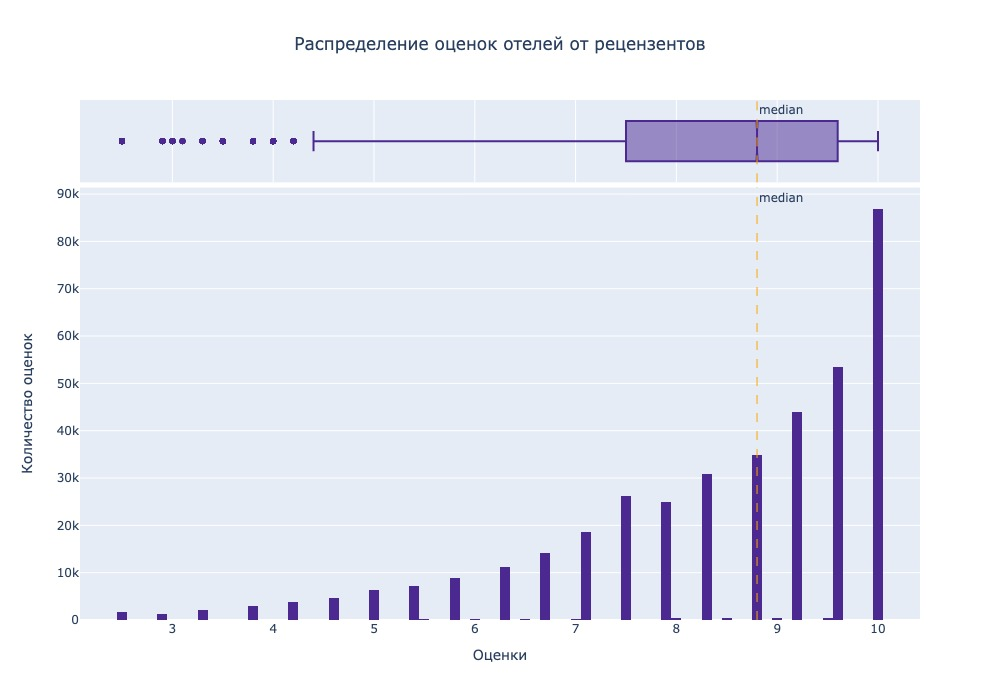

In [32]:
# Посмотрим распределение числового признака - выебрем гистограмму
fig = px.histogram(df_train, 
                    x="reviewer_score",
                    title="Распределение оценок отелей от рецензентов",
                    width = 1000, 
                    height = 700, 
                    color_discrete_sequence=px.colors.sequential.Agsunset,
                    marginal='box',
                )

# Нарисуем линию среднего salary
fig.add_vline(x=df_train['reviewer_score'].median(), 
              line_width=1, 
              line_dash="dash", 
              line_color="orange",
              annotation_text = 'median'
             )

# Обновим данные для осей и названия
fig.update_layout(title_x = 0.5,
                    xaxis_title="Оценки", 
                    yaxis_title="Количество оценок"
                 )

fig.show('jpeg')

<hr style="border-style: dashed;">

__Вывод:__  
- Крайние значения: слева 2.5 (1632 оценки), справа 10 (86803 оценки)
- 50% оценок находится в диапазоне 7.5 - 9.6
- Есть выбросы они находяться слева за оценкой 4.4 (11908 оценок)
- Медианна - 8.8 (34795 оценок), среднее - 8.39 (рядом 8.3 мы видим 30903 оценок), мода - 10 (86803 оценки)
- Распределение оценок не нормальное

<span style="color:#D2691E">
От выбросов мы избавится не сможем так как они вполне себе могут являтся такими. Возможно в отеле в это время было сломано отопление в номере или не работал душ ? Или обманули ожидания и поставили такие оценки.

<hr style="border-style: dashed;">

In [33]:
# удалим дубликаты 
dupl_columns = list(df_train.columns)
# применяем считынанные параметры к функций поиска дубликатов (создаем маску поиска)
mask = df_train.duplicated(subset=dupl_columns)
# Ищем дубликаты
train_duplicates = df_train[mask]
print(f'Число найденных дубликатов: {train_duplicates.shape[0]}')

Число найденных дубликатов: 307


In [34]:
# удалим дубликаты и сбросим индекс
df_train = df_train.drop_duplicates(subset=dupl_columns, ignore_index=True)
print(f'Результирующее число записей: {df_train.shape[0]}')

Результирующее число записей: 386496


In [35]:
# посмотрим на карте - lat, lng
# создаем объект Figure, тип графика – Scattermapbox для визуализации геоданных на карте
fig = go.Figure(go.Scattermapbox(lat=df_train['lat'], lon=df_train['lng']))

# настраиваем карту
fig.update_layout(mapbox_zoom=4, # уровень приближения карты
    mapbox_style='carto-darkmatter', # стиль карты
    margin=dict(t=5, b=5, l=5, r=5), # отступы карты от границ фигуры
    mapbox_center={'lat': 47, 'lon': 6}) # центровка карты 

fig.show();

In [36]:
# Сначала отфильтруем данные, затем сгрупируем по адресу и отелю 
# воспользуемся size - возврашает кол-во элементов
display(df_train[(df_train['lat'].isna()) & (df_train['lng'].isna())].groupby(
    ['hotel_address', 'hotel_name']).size().to_frame())

,,0
hotel_address,hotel_name,
20 Rue De La Ga t 14th arr 75014 Paris France,Mercure Paris Gare Montparnasse,28
23 Rue Damr mont 18th arr 75018 Paris France,Holiday Inn Paris Montmartre,47
4 rue de la P pini re 8th arr 75008 Paris France,Maison Albar Hotel Paris Op ra Diamond,224
Bail n 4 6 Eixample 08010 Barcelona Spain,NH Collection Barcelona Podium,113
Gr nentorgasse 30 09 Alsergrund 1090 Vienna Austria,City Hotel Deutschmeister,63
Hasenauerstra e 12 19 D bling 1190 Vienna Austria,Hotel Park Villa,44
Josefst dter Stra e 10 12 08 Josefstadt 1080 Vienna Austria,Fleming s Selection Hotel Wien City,496
Josefst dter Stra e 22 08 Josefstadt 1080 Vienna Austria,Cordial Theaterhotel Wien,40
Landstra er G rtel 5 03 Landstra e 1030 Vienna Austria,Hotel Daniel Vienna,182


<hr style="border-style: dashed;">

<span style="color:#D2691E">

У нас всего 6 групп координат, мы видим данных нет только - во Франций, Испаний, Австрий. Сгрупируем по адресам в данных страннах и заполним медианной данные, т.к % маленький не думаю что это сильно исказит модель. Здесь в принципе можно было бы и моду выбрать для нас не будет принципиальной разницы.
    
<hr style="border-style: dashed;">

In [46]:
# вычислим медианну для Spain
S_lat = df_train[df_train['hotel_address'].str.contains('Spain')]['lat'].median()
S_lng = df_train[df_train['hotel_address'].str.contains('Spain')]['lng'].median()
S_lat_t = df_test[df_test['hotel_address'].str.contains('Spain')]['lat'].median()
S_lng_t = df_test[df_test['hotel_address'].str.contains('Spain')]['lng'].median()

# заменим пропуски
df_train.loc[df_train['hotel_address'].str.contains('Spain'), ['lat']] = S_lat
df_train.loc[df_train['hotel_address'].str.contains('Spain'), ['lng']] = S_lng
df_test.loc[df_test['hotel_address'].str.contains('Spain'), ['lat']] = S_lat_t
df_test.loc[df_test['hotel_address'].str.contains('Spain'), ['lng']] = S_lat_t

In [47]:
# вычислим медианну для France
F_lat = df_train[df_train['hotel_address'].str.contains('France')]['lat'].median()
F_lng = df_train[df_train['hotel_address'].str.contains('France')]['lng'].median()
F_lat_t = df_test[df_test['hotel_address'].str.contains('France')]['lat'].median()
F_lng_t = df_test[df_test['hotel_address'].str.contains('France')]['lng'].median()

# заменим пропуски
df_train.loc[df_train['hotel_address'].str.contains('France'), ['lat']] = F_lat
df_train.loc[df_train['hotel_address'].str.contains('France'), ['lng']] = F_lng
df_test.loc[df_test['hotel_address'].str.contains('France'), ['lat']] = F_lat_t
df_test.loc[df_test['hotel_address'].str.contains('France'), ['lng']] = F_lng_t

In [48]:
# вычислим медианну для Austria
A_lat = df_train[df_train['hotel_address'].str.contains('Austria')]['lat'].median()
A_lng = df_train[df_train['hotel_address'].str.contains('Austria')]['lng'].median()
A_lat_t = df_test[df_test['hotel_address'].str.contains('Austria')]['lat'].median()
A_lng_t = df_test[df_test['hotel_address'].str.contains('Austria')]['lng'].median()

# заменим пропуски
df_train.loc[df_train['hotel_address'].str.contains('Austria'), ['lat']] = A_lat
df_train.loc[df_train['hotel_address'].str.contains('Austria'), ['lng']] = A_lng
df_test.loc[df_test['hotel_address'].str.contains('Austria'), ['lat']] = A_lat_t
df_test.loc[df_test['hotel_address'].str.contains('Austria'), ['lng']] = A_lng_t

In [207]:
# переведем - days_since_review в цифровой формат
df_train['days_since_review'] = df_train['days_since_review'].apply(
                                                    lambda x: int(x.split()[0]))
df_test['days_since_review'] = df_test['days_since_review'].apply(
                                                    lambda x: int(x.split()[0]))

df_train['days_since_review'].head()

0    531
1    203
2    289
3    681
4    516
Name: days_since_review, dtype: int64

In [64]:
# преобразуем review_date в дататайм
df_train['review_date'] = pd.to_datetime(df_train['review_date'
                                                 ], format='%m/%d/%Y')

df_test['review_date'] = pd.to_datetime(df_test['review_date'
                                                 ], format='%m/%d/%Y')


In [51]:
df_train['review_date'].head()

0   2016-02-19
1   2017-01-12
2   2016-10-18
3   2015-09-22
4   2016-03-05
Name: review_date, dtype: datetime64[ns]

## <center> 2. Генерация признаков. 

<span style="color:#D2691E">   
    
### 2.1 hotel_address - адрес отеля

In [52]:
df_train['hotel_address'].sample(5).to_frame()

,hotel_address
164909,Carlos Place Westminster Borough London W1K 2AL United Kingdom
208790,9 rue Gr goire de Tours 6th arr 75006 Paris France
35292,Via Camperio 9 Milan City Center 20123 Milan Italy
59635,6 Holywell Lane Hackney London EC2A 3ET United Kingdom
300234,Mallorca 1 23 Sants Montju c 08014 Barcelona Spain


<hr style="border-style: dashed;">

<span style="color:#D2691E">
При просмотре данного признака мы можем увидеть, что здесь указаны: улица, район (почтовый индекс), город и страна. Вытащим страну и город, насчет района я не ничего не придумал в контексте данного исследования. Также расчитаем расстояние от центра города, т.к. мой опыт подсказывает, что чем дальше от центра города тем дешевле отель. Хотя это может и не сказаться на качестве обслуживания и следовательно на оценках.
    
<hr style="border-style: dashed;">

In [53]:
# создадим параметр страна
df_train['country'] = df_train['hotel_address'].apply(lambda x: ' '.join(
                x.split()[-2:]) if 'United Kingdom' in x else x.split()[-1])

df_test['country'] = df_test['hotel_address'].apply(lambda x: ' '.join(
                x.split()[-2:]) if 'United Kingdom' in x else x.split()[-1])

In [54]:
# создадим параметр город
df_train['city'] = df_train['hotel_address'].apply(lambda x:
                x.split()[-5] if 'United Kingdom' in x else x.split()[-2])

df_test['city'] = df_test['hotel_address'].apply(lambda x:
                x.split()[-5] if 'United Kingdom' in x else x.split()[-2])

In [55]:
# посмотрим данные на графике
country_city = df_train.groupby(['country', 'city'])['reviewer_score'].mean(
                                                        ).round(2).to_frame()

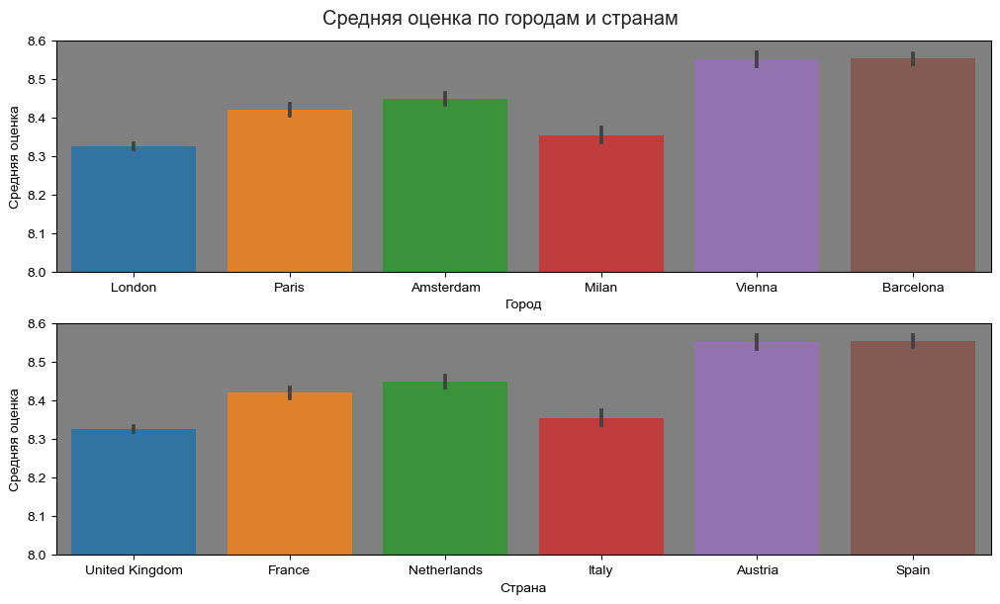

In [56]:
# посмотрим на графике по странам среднию оценку
# настроим графики
figure, (ax1, ax2) = plt.subplots(2, 1, figsize=(10,6), constrained_layout=True, sharey=True)
sns.barplot(df_train, x='city', y='reviewer_score', ax=ax1)
sns.barplot(df_train, x='country', y='reviewer_score', ax=ax2)

# настроим отображение графика
ax1.set_ylim(8, 8.6);
ax2.set_ylim(8, 8.6);
ax1.set(facecolor = 'grey')
ax2.set(facecolor = 'grey')

ax1.set_ylabel('Средняя оценка')
ax2.set_ylabel('Средняя оценка')
ax1.set_xlabel('Город')
ax2.set_xlabel('Страна')
sns.set(rc={"grid.linewidth":1})
plt.suptitle('Средняя оценка по городам и странам');

<hr style="border-style: dashed;">

<span style="color:#D2691E">
Как видим данные повторяют друг друга, имеет смыл закодировать только один признак, а от второго избавится.
    
<hr style="border-style: dashed;">

In [57]:
# закодируем параметр
one_hot = pd.get_dummies(df_train['country'])
one_hot_test = pd.get_dummies(df_test['country'])

# присоединим данные к датафрейму
df_train = df_train.join(one_hot)
df_test = df_test.join(one_hot_test)

In [59]:
# вычислим координаы для центра городов
# создадим словарь
city_geo = {}
# настроим функицю
geolocator = Nominatim_geopy(user_agent="stefs")
# цикл извлекает координаты города и записывает словарь
for i in set(df_train['city']):
    location = geolocator.geocode(i)
    city_geo[i] = location.point[:-1]

# записываем данные по центру города 
df_train['centre_city'] = df_train['city'].apply(lambda x: city_geo[x])
df_test['centre_city'] = df_test['city'].apply(lambda x: city_geo[x])

In [60]:
# вычислим км от центра города до координат отеля
df_train['center_distance'] = df_train.apply(lambda x: geodesic((x['lat'], x['lng']
        ), (x['centre_city'][0], x['centre_city'][1])).kilometers, axis = 1 )

df_test['center_distance'] = df_test.apply(lambda x: geodesic((x['lat'], x['lng']
        ), (x['centre_city'][0], x['centre_city'][1])).kilometers, axis = 1 )

# округлим данные
df_train['center_distance'] = df_train['center_distance'].apply(lambda x: round(x, 2))
df_test['center_distance'] = df_test['center_distance'].apply(lambda x: round(x, 2))

<hr style="border-style: dashed;">

<span style="color:#D2691E">
С помошью OpenStreetMap извлечем, места и вещи, представляющие особый интерес для туристов, включая места, которые стоит посмотреть, места для проживания, вещи и места, предоставляющие туристам информацию и поддержку. Можно было бы еще углубится и кластеризовать данные вокруг точек отелей, но затраты на вычисления слишком большие.

<hr style="border-style: dashed;">

In [412]:
# извлечем с OpenStreetMap данные по объектам исключив отели  
nominatim = Nominatim_OSM(userAgent='stefs')
overpass = Overpass()

# извлечем города и страны
area = df_train[['country', 'city']].value_counts()
#список с исключениями
not_tourism = ['alpine_hut', 'apartment', 'camp_pitch', 'camp_site',
               'caravan_site', 'chalet', 'guest_house', 'hostel', 'hotel', 
               'motel', 'wilderness_hut']

# словарь для сохранения результата
object_for_turism = {}

for i in area.index:
    string = i[1] + ', ' + i[0]
    # обозначаем зону поиска
    areaId = nominatim.query(string).areaId()
    # настраиваем поисковый запрос
    query = overpassQueryBuilder(area=areaId, elementType='node', 
                                                     selector=['"tourism"'])
    # создаем запрос и сохраняем в переменную
    result = overpass.query(query)
    # Применяем метод json()
    currencies = result.toJSON()
    # список для хранения реузльтат
    temp = []
    # Здесь извлекаем инфомацию из тэгов - tourism и подсчитываем
    for j in currencies['elements']:
        if j['tags']['tourism'] not in not_tourism:
             temp.append(j['tags']['tourism'])
        else:
            pass
    # добавляем в словарь данные
    object_for_turism[i[1]] = len(temp)

In [416]:
# сохраним данные в json
with open('data/dictionary_frequency_it.csv','w') as csvfile:
        writer = object_for_turism.writer(csvfile)
        #writer.writerow(object_for_turism)


AttributeError: 'dict' object has no attribute 'writer'

In [414]:
# загрузим данные из json
file = open("data/object_for_turism.json")
object_for_turism_test = json.load(file)
object_for_turism_test

{'London': 4525,
 'Barcelona': 1736,
 'Paris': 4483,
 'Amsterdam': 1223,
 'Vienna': 2448,
 'Milan': 784}

In [62]:
# добавим данные в датасет
df_train['number_tourism'] = df_train['city'].apply(lambda x: object_for_turism[x])
df_test['number_tourism'] = df_test['city'].apply(lambda x: object_for_turism[x])

<span style="color:#D2691E">
    
### 2.2 review_date - дата, когда рецензент разместил соответствующий отзыв. Вытащим год, месяц и день недели.

In [65]:
# получим год, месяц и день недели
# tarin
df_train['review_date'] = pd.to_datetime(df_train['review_date'], 
                                         format='%Y-%m-%d')
df_train['year'] = df_train['review_date'].dt.year
df_train['month'] = df_train['review_date'].dt.month
df_train['day_of_week'] = df_train['review_date'].dt.weekday

# test
df_test['review_date'] = pd.to_datetime(df_test['review_date'], 
                                         format='%Y-%m-%d')
df_test['year'] = df_test['review_date'].dt.year
df_test['month'] = df_test['review_date'].dt.month
df_test['day_of_week'] = df_test['review_date'].dt.weekday

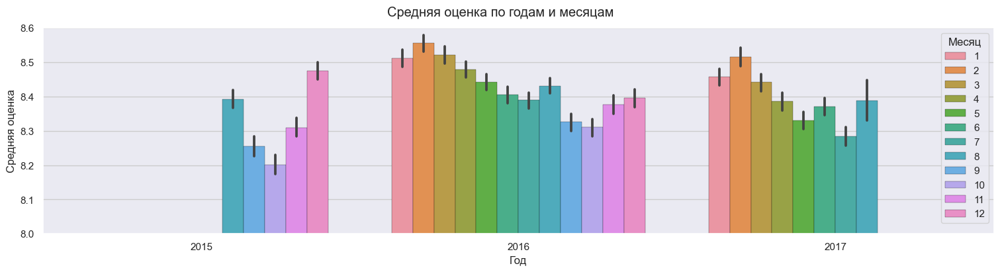

In [86]:
# Посмотрим на графике распределение оценок по месяцам и годам 
figure, (ax) = plt.subplots(1, 1, figsize=(15, 4), 
                                  constrained_layout=True, 
                                  sharey=True
                                 )


rc_style={'patch.edgecolor': 'black',
          'grid.color': '.8',
          'grid.linestyle': "-",
          }

sns.set_style("darkgrid",rc_style)


sns.barplot(x=df_train['year'], 
            y=df_train['reviewer_score'], 
            estimator='mean',
            hue=df_train['month'], 
            linewidth=.2,
           )

# настроим отображение графика
ax.set_ylim(8, 8.6);
ax.set_ylabel('Средняя оценка')
ax.set_xlabel('Год')
plt.legend(title="Месяц")
plt.suptitle('Средняя оценка по годам и месяцам');

<hr style="border-style: dashed;">

<span style="color:#D2691E">

Из графика видно, что у нас каждый год есть определенная тенденция в средней оценки отелей. 
    
<hr style="border-style: dashed;">

<span style="color:#D2691E">
    
### 2.3 hotel_name - название отеля

In [87]:
# попытался выделить общее в название отеля, для идентификаций сети отелей
df_train['acronym_hotel'] = df_train['hotel_name'].apply(
                                            lambda x: ' '.join(x.split()[:2]))

df_test['acronym_hotel'] = df_test['hotel_name'].apply(
                                            lambda x: ' '.join(x.split()[:2]))

In [88]:
# пришлось вручную просмотреть отели, чтоб вычислить причастность к сети отелей
data_acronym = df_train.groupby(['acronym_hotel', 'hotel_name']
                               )['reviewer_nationality'].size().reset_index()
# пример сети отелей
data_acronym[9:16]

,acronym_hotel,hotel_name,reviewer_nationality
9,AC Hotel,AC Hotel Barcelona Forum a Marriott Lifestyle Hotel,216
10,AC Hotel,AC Hotel Diagonal L Illa a Marriott Lifestyle Hotel,43
11,AC Hotel,AC Hotel Irla a Marriott Lifestyle Hotel,12
12,AC Hotel,AC Hotel Milano a Marriott Lifestyle Hotel,59
13,AC Hotel,AC Hotel Paris Porte Maillot by Marriott,60
14,AC Hotel,AC Hotel Sants a Marriott Lifestyle Hotel,67
15,AC Hotel,AC Hotel Victoria Suites a Marriott Lifestyle Hotel,34


In [89]:
#создадим словарь для с акронимом отеля и кол-в отелей с ним
hotel_chain = dict(data_acronym['acronym_hotel'].value_counts())

# поставим флаг если кол-во отелей > 1
data_acronym['hotel_chain'] = data_acronym['acronym_hotel'].apply(
                                    lambda x: 1 if hotel_chain[x] > 1 else 0)

# изучим данные
data_acronym[data_acronym['hotel_chain'] == 1].head()

,acronym_hotel,hotel_name,reviewer_nationality,hotel_chain
9,AC Hotel,AC Hotel Barcelona Forum a Marriott Lifestyle Hotel,216,1
10,AC Hotel,AC Hotel Diagonal L Illa a Marriott Lifestyle Hotel,43,1
11,AC Hotel,AC Hotel Irla a Marriott Lifestyle Hotel,12,1
12,AC Hotel,AC Hotel Milano a Marriott Lifestyle Hotel,59,1
13,AC Hotel,AC Hotel Paris Porte Maillot by Marriott,60,1


<hr style="border-style: dashed;">

<span style="color:#D2691E">
После визуальной оценки выявил некоторые стоп-акронимы: Grand Hotel, Grosvenor House, H tel, Hotel Bristol, Hotel Casa, Hotel La, Hotel Park, Hotel Royal, Hotel The, Hotel Spa, Hotel Villa, Hotel de, Hotel du, Melia Barcelona, Royal Garden, St George, St James, The Park, The Royal.  
Эти акронимы похоже, но не являются сетью отелей, как и отели имеющие их в название.
    
<hr style="border-style: dashed;">

In [90]:
# исправим флаг
# создадим список со стоп словами
no_chain = ['Grand Hotel', 'Grosvenor House', 'H tel', 'Hotel Bristol', 
            'Hotel Casa', 'Hotel La', 'Hotel Park', 'Hotel Royal', 
            'Hotel The', 'Hotel Spa', 'Hotel Villa', 'Hotel de', 'Hotel du', 
            'Melia Barcelona', 'Royal Garden', 'St George', 'St James', 
            'The Park', 'The Royal']

# исправим данные
for i, v in enumerate(data_acronym['acronym_hotel']):
    if v in no_chain:
        data_acronym.loc[i, 'hotel_chain'] = 0
    else:
        pass

In [92]:
# создадим список акронимов отелей которые входят в сети
yes_chain = set(data_acronym[data_acronym['hotel_chain'] == 1
                                 ]['acronym_hotel'])

In [93]:
# добавим размер сети отеля - кол-во отелей в сети: 1 единичный, 2-6 малая сеть
# создадим словарь
acronym_dict = dict(data_acronym['acronym_hotel'].value_counts())
# добавим размер сети отеля - кол-во отелей в сети: 1 единичный, 2-6 малая сеть
# 7-14 среняя сеть, 15 или больше большая сеть
df_train['single_hotel'] = df_train['acronym_hotel'].apply(
                                lambda x: 1 if x not in yes_chain else 0)
df_train['small_chain_hotel'] = df_train['acronym_hotel'].apply(
    lambda x: 1 if (x in yes_chain) & (2 <= acronym_dict[x] <= 6) else 0)
df_train['medium_chain_hotel'] = df_train['acronym_hotel'].apply(
    lambda x: 1 if (x in yes_chain) & (7 <= acronym_dict[x] <= 14) else 0)
df_train['large_chain_hotel'] = df_train['acronym_hotel'].apply(
            lambda x: 1 if (x in yes_chain) & (acronym_dict[x] >= 15) else 0)

df_test['single_hotel'] = df_test['acronym_hotel'].apply(
                                lambda x: 1 if x not in yes_chain else 0)
df_test['small_chain_hotel'] = df_test['acronym_hotel'].apply(
    lambda x: 1 if (x in yes_chain) & (2 <= acronym_dict[x] <= 6) else 0)
df_test['medium_chain_hotel'] = df_test['acronym_hotel'].apply(
    lambda x: 1 if (x in yes_chain) & (7 <= acronym_dict[x] <= 14) else 0)
df_test['large_chain_hotel'] = df_test['acronym_hotel'].apply(
            lambda x: 1 if (x in yes_chain) & (acronym_dict[x] >= 15) else 0)

<span style="color:#D2691E">
    
### 2.4 reviewer_nationality - национальность рецензента

In [94]:
# объединим в группы по численности, посмотрим уникальные значения в группах
df_train['reviewer_nationality'].value_counts().unique()


array([184033,  26541,  16239,  11126,   7617,   6722,   6608,   6498,
         5984,   5956,   5543,   4918,   4562,   4529,   4105,   3702,
         3529,   3425,   2953,   2888,   2564,   2562,   2559,   2536,
         2445,   2311,   2262,   2106,   2047,   1817,   1786,   1778,
         1719,   1707,   1666,   1431,   1405,   1389,   1379,   1346,
         1288,   1251,   1180,   1164,   1019,   1017,   1013,    996,
          977,    948,    845,    830,    815,    802,    733,    710,
          682,    676,    665,    655,    574,    563,    555,    547,
          530,    448,    405,    395,    367,    300,    274,    254,
          225,    222,    219,    217,    216,    214,    213,    207,
          203,    188,    177,    163,    142,    141,    140,    139,
          119,    116,    114,    107,    100,     90,     89,     86,
           83,     82,     78,     77,     72,     61,     58,     57,
           55,     53,     52,     51,     47,     44,     43,     41,
      

<hr style="border-style: dashed;">

<span style="color:#D2691E">

Получилось 141 уникальное значение по численности представителей национальности (всего 225 наций представленно).
Разделим на 5 групп туристов и поставим флаги:
- 1 - 100 very_small, 
- 101 - 1000 small, 
- 1001 - 10000 medium, 
- 10001 - 100000 big,
- 100001 и более very_big
    
<hr style="border-style: dashed;">

In [96]:
# создаем словарь для обрашения к нему и сравнения кол-ва рецензентов
amount_of_tourist = dict(df_train['reviewer_nationality'].value_counts())

df_train['very_small'] = df_train['reviewer_nationality'].apply(
                            lambda x: 1 if amount_of_tourist[x] <= 100 else 0)
df_train['small'] = df_train['reviewer_nationality'].apply(
                    lambda x: 1 if 101 <= amount_of_tourist[x] <= 1000 else 0)
df_train['medium'] = df_train['reviewer_nationality'].apply(
                lambda x: 1 if 1001 <= amount_of_tourist[x] <= 10000 else 0)
df_train['big'] = df_train['reviewer_nationality'].apply(
                lambda x: 1 if 10001 <= amount_of_tourist[x] <= 100000 else 0)
df_train['very_big'] = df_train['reviewer_nationality'].apply(
                        lambda x: 1 if amount_of_tourist[x] > 100001 else 0)

amount_of_tourist_test = dict(df_test['reviewer_nationality'].value_counts())

df_test['very_small'] = df_test['reviewer_nationality'].apply(
                            lambda x: 1 if amount_of_tourist_test[x] <= 100 else 0)
df_test['small'] = df_test['reviewer_nationality'].apply(
                    lambda x: 1 if 101 <= amount_of_tourist_test[x] <= 1000 else 0)
df_test['medium'] = df_test['reviewer_nationality'].apply(
                lambda x: 1 if 1001 <= amount_of_tourist_test[x] <= 10000 else 0)
df_test['big'] = df_test['reviewer_nationality'].apply(
                lambda x: 1 if 10001 <= amount_of_tourist_test[x] <= 100000 else 0)
df_test['very_big'] = df_test['reviewer_nationality'].apply(
                        lambda x: 1 if amount_of_tourist_test[x] > 100001 else 0)

<span style="color:#D2691E">
    
### 2.5 negative_review, positive_review - отрицательный и положительный отзыв, который рецензент дал отелю.

In [97]:
# уберем пробелы и переведем в нижний регистр
df_train['negative_review'] = df_train['negative_review'].apply(
                                                lambda x: x.lower().strip())
df_train['positive_review'] = df_train['positive_review'].apply(
                                                lambda x: x.lower().strip())

df_test['negative_review'] = df_test['negative_review'].apply(
                                                lambda x: x.lower().strip())
df_test['positive_review'] = df_test['positive_review'].apply(
                                                lambda x: x.lower().strip())

# также у нас есть пустые строки вместо отзыва, заменим их на neutral для
# корректности т.к. будем делать семантический анализ отзывов
df_train['negative_review'] = df_train['negative_review'].apply(
                                        lambda x: x if x != '' else 'neutral')
df_train['positive_review'] = df_train['positive_review'].apply(
                                        lambda x: x if x != '' else 'neutral')

df_test['negative_review'] = df_test['negative_review'].apply(
                                        lambda x: x if x != '' else 'neutral')
df_test['positive_review'] = df_test['positive_review'].apply(
                                        lambda x: x if x != '' else 'neutral')


In [99]:
# количество изменненых строк
display(df_train[df_train['negative_review'] == 'neutral'].shape[0])
display(df_train[df_train['positive_review'] == 'neutral'].shape[0])
display(df_test[df_test['negative_review'] == 'neutral'].shape[0])
display(df_test[df_test['positive_review'] == 'neutral'].shape[0])

606

128

243

55

<hr style="border-style: dashed;">

<span style="color:#D2691E">
    
При изучение данных, обнаружил что здесь около 30 языков написания отзыва.   
Самый популярный Англиский более 1/2, затем идут Итальянский примерно 1/4, затем Словенский (10795) - это состовляет 95% отзывов. Менее 10000 отзывов Африканс (западногерманский язык из голладнского наречья), Филиппинский (Tagalog) и затем европейские языки. Далее от 100 до 1000 отзывов идут как правило европейские языки, за исключением Сомалийского (Somali - используеться также в Эфиопий). В основном по Евпропе как видим ездят люди со знанием английского языка, либо итальянского (удивительно!).  


Сделаем токенизацию, затем сделаем стеминг (приведем слова к основе) и в конце сделаем лематизацию (приведем слово к лемме, учитываеться контекст), затем мы подвергнем это анализу и посомтрим, что будет по оценкам.

При удаление стоп-слов из словаря сильно искажается контекст отзыва
    
<hr style="border-style: dashed;">

In [100]:
# tokenisation 

df_train['negative_review_tokens'] = df_train['negative_review'].apply(
                                                    lambda x: tokenisation(x))
df_train['positive_review_tokens'] = df_train['positive_review'].apply(
                                                    lambda x: tokenisation(x))

df_test['negative_review_tokens'] = df_test['negative_review'].apply(
                                                    lambda x: tokenisation(x))
df_test['positive_review_tokens'] = df_test['positive_review'].apply(
                                                    lambda x: tokenisation(x))

In [101]:
# stemming - приведение слова к его основе, основа слова может не совпадать
# с морфологическим корнем слова, будем использовать PorterStemmer

df_train['negative_review_stemming'] = df_train['negative_review_tokens'
                                               ].apply(lambda x: stemming(x))
df_train['positive_review_stemming'] = df_train['positive_review_tokens'
                                               ].apply(lambda x: stemming(x))

df_test['negative_review_stemming'] = df_test['negative_review_tokens'
                                               ].apply(lambda x: stemming(x))
df_test['positive_review_stemming'] = df_test['positive_review_tokens'
                                               ].apply(lambda x: stemming(x))

In [102]:
# lemmatising - процесс приведения словоформы к лемме — её нормальной форме используем WordNet

df_train['negative_review_lemmatising'] = df_train['negative_review_tokens'
                                            ].apply(lambda x: lemmatising(x))
df_train['positive_review_lemmatising'] = df_train['positive_review_tokens'
                                            ].apply(lambda x: lemmatising(x))

df_test['negative_review_lemmatising'] = df_test['negative_review_tokens'
                                            ].apply(lambda x: lemmatising(x))
df_test['positive_review_lemmatising'] = df_test['positive_review_tokens'
                                            ].apply(lambda x: lemmatising(x))

In [103]:
# вернем слова обратно в строку для анализа полярности

df_train['negative_review_stemming_str'] = df_train['negative_review_stemming'
                                                ].apply(lambda x: strings(x))
df_train['negative_review_lemmatising_str'] = df_train[
                    'negative_review_lemmatising'].apply(lambda x: strings(x))
df_train['positive_review_stemming_str'] = df_train['positive_review_stemming'
                                                ].apply(lambda x: strings(x))
df_train['positive_review_lemmatising_str'] = df_train[
                    'positive_review_lemmatising'].apply(lambda x: strings(x))
####
df_test['negative_review_stemming_str'] = df_test['negative_review_stemming'
                                                ].apply(lambda x: strings(x))
df_test['negative_review_lemmatising_str'] = df_test[
                    'negative_review_lemmatising'].apply(lambda x: strings(x))
df_test['positive_review_stemming_str'] = df_test['positive_review_stemming'
                                                ].apply(lambda x: strings(x))
df_test['positive_review_lemmatising_str'] = df_test[
                    'positive_review_lemmatising'].apply(lambda x: strings(x))

<hr style="border-style: dashed;">

<span style="color:#D2691E">

И так мы подготовили слова, теперь посмотрим как работают программы для семантического анализа (анализа настроений), для ускорения процесса мы возмем 50 случайных отзывов содержашими не более 10 слов, так как в процессе тестирования выяснилось, что библиотеки достаточно длинные предложения идентифицируют достаточно хорошо, хоть и присутсутствует своя специфика.
    
<hr style="border-style: dashed;">

In [105]:
# Выберем половины отзывов из датасета, которые имеют менее 11 слов
negative_review_10 = df_train[df_train['review_total_negative_word_counts'
                                      ] < 11][['negative_review', 
        'negative_review_stemming_str', 'negative_review_lemmatising_str']]
positive_review_10 = df_train[df_train['review_total_positive_word_counts'
                                      ] < 11][['positive_review', 
        'positive_review_stemming_str', 'positive_review_lemmatising_str']]


# Возмем случайные 50 слов и проведем анализ
negative_review_10_df = negative_review_10.value_counts().sample(50).reset_index()
negative_review_10_df = negative_review_10_df[['negative_review', 
        'negative_review_stemming_str', 'negative_review_lemmatising_str']]

positive_review_10_df = positive_review_10.value_counts().sample(50).reset_index()
positive_review_10_df = positive_review_10[['positive_review', 
        'positive_review_stemming_str', 'positive_review_lemmatising_str']]


# Посмотрим, как оригинальные отзывы оценены 
negative_review_10_df = afinn_analysis(negative_review_10_df, 'negative_review',
                                 'n_origin', afinn)
positive_review_10_df = afinn_analysis(positive_review_10_df, 'positive_review',
                                 'p_origin', afinn)


# отзывы подвергшиеся stemming
negative_review_10_df = afinn_analysis(negative_review_10_df, 
                        'negative_review_stemming_str', 'n_stemming', afinn)
positive_review_10_df = afinn_analysis(positive_review_10_df, 
                        'positive_review_stemming_str', 'p_stemming', afinn)


# отзывы подвергшиеся lemmatising
negative_review_10_df = afinn_analysis(negative_review_10_df, 
                    'negative_review_lemmatising_str', 'n_lemmatising', afinn)
positive_review_10_df = afinn_analysis(positive_review_10_df, 
                    'positive_review_lemmatising_str', 'p_lemmatising', afinn)



In [106]:
display(negative_review_10_df.head())
display(positive_review_10_df.head())

,negative_review,negative_review_stemming_str,negative_review_lemmatising_str,afinn_n_origin_score,afinn_n_stemming_score,afinn_n_lemmatising_score
0,curtains were hanging off hooks,curtain were hang off hook,curtain were hanging off hook,0.0,0.0,0.0
1,size of the room is too small,size of the room is too small,size of the room is too small,0.0,0.0,0.0
2,better bath products would be a nice add,better bath product would be a nice add,better bath product would be a nice add,5.0,5.0,5.0
3,cooked breakfast should have been hotter,cook breakfast should have been hotter,cooked breakfast should have been hotter,0.0,0.0,0.0
4,very small hotel rooms,veri small hotel room,very small hotel room,0.0,0.0,0.0


,positive_review,positive_review_stemming_str,positive_review_lemmatising_str,afinn_p_origin_score,afinn_p_stemming_score,afinn_p_lemmatising_score
0,staff were amazing,staff were amaz,staff were amazing,4.0,0.0,4.0
1,location,locat,location,0.0,0.0,0.0
2,no positive,no posit,no positive,1.0,-1.0,1.0
8,staff very good location wonderful,staff veri good locat wonder,staff very good location wonderful,7.0,3.0,7.0
9,no positive,no posit,no positive,1.0,-1.0,1.0


<hr style="border-style: dashed;">

<span style="color:#D2691E">

Семантический анализ Afinn неплохо справляется если, в отзыве присутствет явное отрицание или позитивное отношение, но здесь есть нюанс (no compl) идентифицируется как негативное, хотя по смыслу это скорее нейтральное. Также есть проблемы с определением без отрицательной частицы ('prices to expensive for the room'), оценивается как нейтральное, хотя смысл негативный вкладывается и тд.
    
<hr style="border-style: dashed;">

In [108]:
# около 30 минут
# оригинальные отзывы
df_train = afinn_analysis(df_train, 'negative_review', 'n_origin', afinn)
df_train = afinn_analysis(df_train, 'positive_review', 'p_origin', afinn)

df_test = afinn_analysis(df_test, 'negative_review', 'n_origin', afinn)
df_test = afinn_analysis(df_test, 'positive_review', 'p_origin', afinn)


# отзывы подвергшиеся stemming
df_train = afinn_analysis(df_train, 'negative_review_stemming_str', 'n_stemming',
                    afinn)
df_train = afinn_analysis(df_train, 'positive_review_stemming_str', 'p_stemming', 
                    afinn)

df_test = afinn_analysis(df_test, 'negative_review_stemming_str', 'n_stemming',
                    afinn)
df_test = afinn_analysis(df_test, 'positive_review_stemming_str', 'p_stemming', 
                    afinn)


# отзывы подвергшиеся lemmatising
df_train = afinn_analysis(df_train, 
                    'negative_review_lemmatising_str', 'n_lemmatising', afinn)
df_train = afinn_analysis(df_train, 
                    'positive_review_lemmatising_str', 'p_lemmatising', afinn)

df_test = afinn_analysis(df_test, 
                    'negative_review_lemmatising_str', 'n_lemmatising', afinn)
df_test = afinn_analysis(df_test, 
                    'positive_review_lemmatising_str', 'p_lemmatising', afinn)


In [110]:
# негативные
negative_review_10_df = vader_analysis(negative_review_10_df,
                                       'negative_review', 'n_origin', vader)
negative_review_10_df = vader_analysis(negative_review_10_df, 
                        'negative_review_stemming_str', 'n_stemming', vader)
negative_review_10_df = vader_analysis(negative_review_10_df, 
                    'negative_review_lemmatising_str', 'n_lemmatising', vader)
# позитивные
positive_review_10_df = vader_analysis(positive_review_10_df, 
                                       'positive_review', 'p_origin', vader)
positive_review_10_df = vader_analysis(positive_review_10_df, 
                        'positive_review_stemming_str', 'p_stemming', vader)
positive_review_10_df = vader_analysis(positive_review_10_df, 
                    'positive_review_lemmatising_str', 'p_lemmatising', vader)

In [111]:
display(negative_review_10_df.head())
display(positive_review_10_df.head())

,negative_review,negative_review_stemming_str,negative_review_lemmatising_str,afinn_n_origin_score,afinn_n_stemming_score,afinn_n_lemmatising_score,vader_n_origin_neg,vader_n_origin_neu,vader_n_origin_pos,vader_n_origin_compound,vader_n_stemming_neg,vader_n_stemming_neu,vader_n_stemming_pos,vader_n_stemming_compound,vader_n_lemmatising_neg,vader_n_lemmatising_neu,vader_n_lemmatising_pos,vader_n_lemmatising_compound
0,curtains were hanging off hooks,curtain were hang off hook,curtain were hanging off hook,0.0,0.0,0.0,0.0,1.000,0.000,0.0000,0.0,1.000,0.000,0.0000,0.0,1.000,0.000,0.0000
1,size of the room is too small,size of the room is too small,size of the room is too small,0.0,0.0,0.0,0.0,1.000,0.000,0.0000,0.0,1.000,0.000,0.0000,0.0,1.000,0.000,0.0000
2,better bath products would be a nice add,better bath product would be a nice add,better bath product would be a nice add,5.0,5.0,5.0,0.0,0.513,0.487,0.6908,0.0,0.513,0.487,0.6908,0.0,0.513,0.487,0.6908
3,cooked breakfast should have been hotter,cook breakfast should have been hotter,cooked breakfast should have been hotter,0.0,0.0,0.0,0.0,1.000,0.000,0.0000,0.0,1.000,0.000,0.0000,0.0,1.000,0.000,0.0000
4,very small hotel rooms,veri small hotel room,very small hotel room,0.0,0.0,0.0,0.0,1.000,0.000,0.0000,0.0,1.000,0.000,0.0000,0.0,1.000,0.000,0.0000


,positive_review,positive_review_stemming_str,positive_review_lemmatising_str,afinn_p_origin_score,afinn_p_stemming_score,afinn_p_lemmatising_score,vader_p_origin_neg,vader_p_origin_neu,vader_p_origin_pos,vader_p_origin_compound,vader_p_stemming_neg,vader_p_stemming_neu,vader_p_stemming_pos,vader_p_stemming_compound,vader_p_lemmatising_neg,vader_p_lemmatising_neu,vader_p_lemmatising_pos,vader_p_lemmatising_compound
0,staff were amazing,staff were amaz,staff were amazing,4.0,0.0,4.0,0.000,0.345,0.655,0.5859,0.000,1.000,0.00,0.0000,0.000,0.345,0.655,0.5859
1,location,locat,location,0.0,0.0,0.0,0.000,1.000,0.000,0.0000,0.000,1.000,0.00,0.0000,0.000,1.000,0.000,0.0000
2,no positive,no posit,no positive,1.0,-1.0,1.0,0.745,0.255,0.000,-0.4449,0.688,0.312,0.00,-0.2960,0.745,0.255,0.000,-0.4449
8,staff very good location wonderful,staff veri good locat wonder,staff very good location wonderful,7.0,3.0,7.0,0.000,0.295,0.705,0.7996,0.000,0.580,0.42,0.4404,0.000,0.295,0.705,0.7996
9,no positive,no posit,no positive,1.0,-1.0,1.0,0.745,0.255,0.000,-0.4449,0.688,0.312,0.00,-0.2960,0.745,0.255,0.000,-0.4449


<hr style="border-style: dashed;">

<span style="color:#D2691E">
Здесь также повторяется те же проблемы, что и в afinn, хотя и видно, что vader  лучше распознает текст ('the heater did not function well') оценивает как отрицательное, в то время как  afinn нейтрально.   
Также в отличие от afinn, этот анализатор помимо общей оценки выводит также оценку нейтральности, позитивности и неготивности и только потом суммирует общую оценку.     

<hr style="border-style: dashed;">

In [112]:
# около 5 минут
# негативные
df_train = vader_analysis(df_train, 'negative_review', 'n_origin', vader)
df_train = vader_analysis(df_train, 'negative_review_stemming_str', 'n_stemming', vader)
df_train = vader_analysis(df_train, 'negative_review_lemmatising_str', 'n_lemmatising', vader)

df_test = vader_analysis(df_test, 'negative_review', 'n_origin', vader)
df_test = vader_analysis(df_test, 'negative_review_stemming_str', 'n_stemming', vader)
df_test = vader_analysis(df_test, 'negative_review_lemmatising_str', 'n_lemmatising', vader)

# позитивные
df_train = vader_analysis(df_train, 'positive_review', 'p_origin', vader)
df_train = vader_analysis(df_train, 'positive_review_stemming_str', 'p_stemming', vader)
df_train = vader_analysis(df_train, 'positive_review_lemmatising_str', 'p_lemmatising', vader)

df_test = vader_analysis(df_test, 'positive_review', 'p_origin', vader)
df_test = vader_analysis(df_test, 'positive_review_stemming_str', 'p_stemming', vader)
df_test = vader_analysis(df_test, 'positive_review_lemmatising_str', 'p_lemmatising', vader)

In [115]:
# негативные
negative_review_10_df = textblob_analysis(negative_review_10_df, 'negative_review', 
                                          'n_origin', textblob)
negative_review_10_df = textblob_analysis(negative_review_10_df, 
                    'negative_review_stemming_str', 'n_stemming', textblob)
negative_review_10_df = textblob_analysis(negative_review_10_df, 
                'negative_review_lemmatising_str', 'n_lemmatising', textblob)

# позитивные
positive_review_10_df = textblob_analysis(positive_review_10_df, 
                                    'positive_review', 'p_origin', textblob)
positive_review_10_df = textblob_analysis(positive_review_10_df, 
                    'positive_review_stemming_str', 'p_stemming', textblob)
positive_review_10_df = textblob_analysis(positive_review_10_df, 
                'positive_review_lemmatising_str', 'p_lemmatising', textblob)

In [116]:
display(negative_review_10_df.head())
display(positive_review_10_df.head())

,negative_review,negative_review_stemming_str,negative_review_lemmatising_str,afinn_n_origin_score,afinn_n_stemming_score,afinn_n_lemmatising_score,vader_n_origin_neg,vader_n_origin_neu,vader_n_origin_pos,vader_n_origin_compound,...,vader_n_lemmatising_neg,vader_n_lemmatising_neu,vader_n_lemmatising_pos,vader_n_lemmatising_compound,tb_n_origin_polarity,tb_n_origin_subjectivity,tb_n_stemming_polarity,tb_n_stemming_subjectivity,tb_n_lemmatising_polarity,tb_n_lemmatising_subjectivity
0,curtains were hanging off hooks,curtain were hang off hook,curtain were hanging off hook,0.0,0.0,0.0,0.0,1.000,0.000,0.0000,...,0.0,1.000,0.000,0.0000,0.000,0.00,0.00,0.00,0.000,0.00
1,size of the room is too small,size of the room is too small,size of the room is too small,0.0,0.0,0.0,0.0,1.000,0.000,0.0000,...,0.0,1.000,0.000,0.0000,-0.250,0.40,-0.25,0.40,-0.250,0.40
2,better bath products would be a nice add,better bath product would be a nice add,better bath product would be a nice add,5.0,5.0,5.0,0.0,0.513,0.487,0.6908,...,0.0,0.513,0.487,0.6908,0.550,0.75,0.55,0.75,0.550,0.75
3,cooked breakfast should have been hotter,cook breakfast should have been hotter,cooked breakfast should have been hotter,0.0,0.0,0.0,0.0,1.000,0.000,0.0000,...,0.0,1.000,0.000,0.0000,0.000,0.00,0.00,0.00,0.000,0.00
4,very small hotel rooms,veri small hotel room,very small hotel room,0.0,0.0,0.0,0.0,1.000,0.000,0.0000,...,0.0,1.000,0.000,0.0000,-0.325,0.52,-0.25,0.40,-0.325,0.52


,positive_review,positive_review_stemming_str,positive_review_lemmatising_str,afinn_p_origin_score,afinn_p_stemming_score,afinn_p_lemmatising_score,vader_p_origin_neg,vader_p_origin_neu,vader_p_origin_pos,vader_p_origin_compound,...,vader_p_lemmatising_neg,vader_p_lemmatising_neu,vader_p_lemmatising_pos,vader_p_lemmatising_compound,tb_p_origin_polarity,tb_p_origin_subjectivity,tb_p_stemming_polarity,tb_p_stemming_subjectivity,tb_p_lemmatising_polarity,tb_p_lemmatising_subjectivity
0,staff were amazing,staff were amaz,staff were amazing,4.0,0.0,4.0,0.000,0.345,0.655,0.5859,...,0.000,0.345,0.655,0.5859,0.600000,0.900000,0.0,0.0,0.600000,0.900000
1,location,locat,location,0.0,0.0,0.0,0.000,1.000,0.000,0.0000,...,0.000,1.000,0.000,0.0000,0.000000,0.000000,0.0,0.0,0.000000,0.000000
2,no positive,no posit,no positive,1.0,-1.0,1.0,0.745,0.255,0.000,-0.4449,...,0.745,0.255,0.000,-0.4449,-0.113636,0.545455,0.0,0.0,-0.113636,0.545455
8,staff very good location wonderful,staff veri good locat wonder,staff very good location wonderful,7.0,3.0,7.0,0.000,0.295,0.705,0.7996,...,0.000,0.295,0.705,0.7996,0.955000,0.890000,0.7,0.6,0.955000,0.890000
9,no positive,no posit,no positive,1.0,-1.0,1.0,0.745,0.255,0.000,-0.4449,...,0.745,0.255,0.000,-0.4449,-0.113636,0.545455,0.0,0.0,-0.113636,0.545455


<hr style="border-style: dashed;">

<span style="color:#D2691E">
Эта библиотеа порадовала тем, что она некоторые отзывы распознает очень неплохо 'beds could have been slightly softer' - присвоила негативную полярность, в то вермя как афинна и вадер назначили нейтральную. Также помимо полярности (-1/1) данная биб-ка показывает вероятность (0 - объективная / 1 субъективная)

<hr style="border-style: dashed;">
    
В общем и целом можно сказать, что данные библиотеки дополняют друг друга в плане анализа.

In [117]:
# около 23 минут
# негативные
df_train = textblob_analysis(df_train, 'negative_review', 'n_origin', textblob)
df_train = textblob_analysis(df_train, 'negative_review_stemming_str',
                                    'n_stemming', textblob)
df_train = textblob_analysis(df_train, 'negative_review_lemmatising_str',
                                    'n_lemmatising', textblob)

df_test = textblob_analysis(df_test, 'negative_review', 'n_origin', textblob)
df_test = textblob_analysis(df_test, 'negative_review_stemming_str',
                                    'n_stemming', textblob)
df_test = textblob_analysis(df_test, 'negative_review_lemmatising_str',
                                    'n_lemmatising', textblob)

# позитивные
df_train = textblob_analysis(df_train, 'positive_review', 'p_origin', textblob)
df_train = textblob_analysis(df_train, 'positive_review_stemming_str', 
                                    'p_stemming', textblob)
df_train = textblob_analysis(df_train, 'positive_review_lemmatising_str',
                                    'p_lemmatising', textblob)

df_test = textblob_analysis(df_test, 'positive_review', 'p_origin', textblob)
df_test = textblob_analysis(df_test, 'positive_review_stemming_str', 
                                    'p_stemming', textblob)
df_test = textblob_analysis(df_test, 'positive_review_lemmatising_str',
                                    'p_lemmatising', textblob)

<span style="color:#D2691E">
    
#### Посмотрим на графике данные по анализу настроений и распределенние оценок.

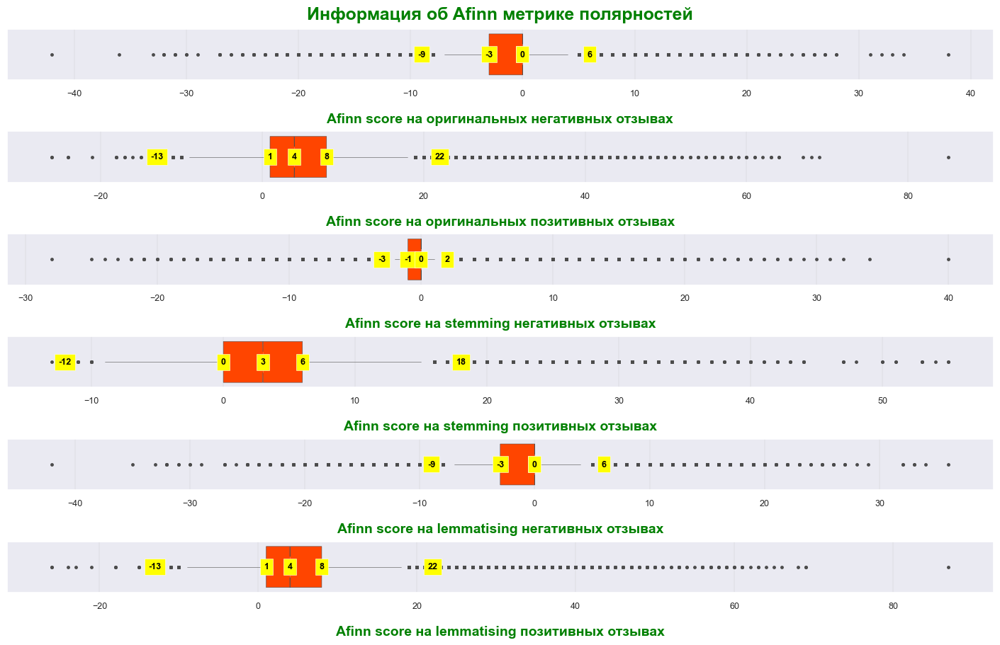

In [122]:
# Afinn
figure, (ax1, ax2, ax3, ax4, ax5, ax6) = plt.subplots(6, 1, figsize=(14, 9), constrained_layout=True)
# Выставим тему и стиль для графиков
sns.set_theme(style="whitegrid", palette="pastel")

rc_style={'patch.edgecolor': 'w',
          'grid.color': '.8',
          'grid.linestyle': "-",
          }
sns.set(rc={"grid.linewidth":.3})
sns.set_style("darkgrid",rc_style)

#-------------------------------------------------------------------------

# оригинальные негативные метрики
sns.boxplot(data=df_train,
            x="afinn_n_origin_score",
            notch=True,
            showcaps=False,
            flierprops={"marker": "."},
            boxprops={"facecolor": '#FF4500'},
            medianprops={"color": "coral"},
            linewidth=.4,
            ax = ax1
            );

# вычислим значения квантилей, медианы на графике
q1 = df_train['afinn_n_origin_score'
             ].quantile([.25]).item()
q3 = df_train['afinn_n_origin_score'
             ].quantile([.75]).item()

iqr = q3 - q1

text_data = [df_train['afinn_n_origin_score'
                     ].median(), 
             q1,
             q3,
             q1 - 2 * iqr,
             q3 + 2 *iqr
            ]

# нанесем значение на график afinn_n_origin_score
for text in text_data:
    ax1.text(text, # медианн
                0, 
                f'{text:.0f}', 
                ha='center', 
                va='center', 
                fontweight='bold', 
                size=9,
                color='black',
                bbox=dict(facecolor='#FFFF00',linewidth = .4))
#-------------------------------------------------------------------------    

# оригинальные позитивные метрики
sns.boxplot(data=df_train,
            x="afinn_p_origin_score",
            notch=True,
            showcaps=False,
            flierprops={"marker": "."},
            boxprops={"facecolor": '#FF4500'},
            medianprops={"color": "coral"},
            linewidth=.4,
            ax = ax2
            );

# вычислим значения квантилей, медианы на графике
q1 = df_train['afinn_p_origin_score'
             ].quantile([.25]).item()
q3 = df_train['afinn_p_origin_score'
             ].quantile([.75]).item()

iqr = q3 - q1

text_data = [df_train['afinn_p_origin_score'
                     ].median(),
             q1,
             q3,
             q1 - 2 * iqr,
             q3 + 2 *iqr
            ]

# нанесем значение на график
for text in text_data:
    ax2.text(text, # медианна
             0, 
             f'{text:.0f}', 
             ha='center', 
             va='center', 
             fontweight='bold', 
             size=9,
             color='black',
             bbox=dict(facecolor='#FFFF00',linewidth = .4))

#-------------------------------------------------------------------------
#-------------------------------------------------------------------------
    
# негативные метрики подвергшиеся стеммингу
sns.boxplot(data=df_train,
            x="afinn_n_stemming_score",
            notch=True,
            showcaps=False,
            flierprops={"marker": "."},
            boxprops={"facecolor": '#FF4500'},
            medianprops={"color": "coral"},
            linewidth=.4,
            ax = ax3
            );

# вычислим значения квантилей, медианы на графике
q1 = df_train['afinn_n_stemming_score'
             ].quantile([.25]).item()
q3 = df_train['afinn_n_stemming_score'
             ].quantile([.75]).item()

iqr = q3 - q1

text_data = [df_train['afinn_n_stemming_score'
                     ].median(),
             q1,
             q3,
             q1 - 2 * iqr,
             q3 + 2 *iqr
            ]

# нанесем значение на график
for text in text_data:
    ax3.text(text, # медианна
             0, 
             f'{text:.0f}', 
             ha='center', 
             va='center', 
             fontweight='bold', 
             size=9,
             color='black',
             bbox=dict(facecolor='#FFFF00',linewidth = .4))

#-------------------------------------------------------------------------
    
# позитивные метрики подвергшиеся стеммингу
sns.boxplot(data=df_train,
            x="afinn_p_stemming_score",
            notch=True,
            showcaps=False,
            flierprops={"marker": "."},
            boxprops={"facecolor": '#FF4500'},
            medianprops={"color": "coral"},
            linewidth=.4,
            ax = ax4
            );

# вычислим значения квантилей, медианы на графике
q1 = df_train['afinn_p_stemming_score'
             ].quantile([.25]).item()
q3 = df_train['afinn_p_stemming_score'
             ].quantile([.75]).item()

iqr = q3 - q1

text_data = [df_train['afinn_p_stemming_score'
                     ].median(),
             q1,
             q3,
             q1 - 2 * iqr,
             q3 + 2 *iqr
            ]

# нанесем значение на график
for text in text_data:
    ax4.text(text, # медианна
             0, 
             f'{text:.0f}', 
             ha='center', 
             va='center', 
             fontweight='bold', 
             size=9,
             color='black',
             bbox=dict(facecolor='#FFFF00',linewidth = .4))

#---------------------------------------------------------------------
#---------------------------------------------------------------------

# негативные метрики подвергшиеся лемматизаций
sns.boxplot(data=df_train,
            x="afinn_n_lemmatising_score",
            notch=True,
            showcaps=False,
            flierprops={"marker": "."},
            boxprops={"facecolor": '#FF4500'},
            medianprops={"color": "coral"},
            linewidth=.4,
            ax = ax5
            );

# вычислим значения квантилей, медианы на графике
q1 = df_train['afinn_n_lemmatising_score'
             ].quantile([.25]).item()
q3 = df_train['afinn_n_lemmatising_score'
             ].quantile([.75]).item()

iqr = q3 - q1

text_data = [df_train['afinn_n_lemmatising_score'
                     ].median(),
             q1,
             q3,
             q1 - 2 * iqr,
             q3 + 2 *iqr
            ]

# нанесем значение на график
for text in text_data:
    ax5.text(text, # медианна
             0, 
             f'{text:.0f}', 
             ha='center', 
             va='center', 
             fontweight='bold', 
             size=9,
             color='black',
             bbox=dict(facecolor='#FFFF00',linewidth = .4))

#-------------------------------------------------------------------------
    
# позитивные метрики подвергшиеся лемматизаций
sns.boxplot(data=df_train,
            x="afinn_p_lemmatising_score",
            notch=True,
            showcaps=False,
            flierprops={"marker": "."},
            boxprops={"facecolor": '#FF4500'},
            medianprops={"color": "coral"},
            linewidth=.4,
            ax = ax6
            );

# вычислим значения квантилей, медианы на графике
q1 = df_train['afinn_p_lemmatising_score'
             ].quantile([.25]).item()
q3 = df_train['afinn_p_lemmatising_score'
             ].quantile([.75]).item()

iqr = q3 - q1

text_data = [df_train['afinn_p_lemmatising_score'
                     ].median(),
             q1,
             q3,
             q1 - 2 * iqr,
             q3 + 2 *iqr
            ]

# нанесем значение на график
for text in text_data:
    ax6.text(text, # медианна
             0, 
             f'{text:.0f}', 
             ha='center', 
             va='center', 
             fontweight='bold', 
             size=9,
             color='black',
             bbox=dict(facecolor='#FFFF00',linewidth = .4))

    
#---------------------------------------------------------------------
#---------------------------------------------------------------------
    

# модефицируем название графика, размеры шрифта и тд.
plt.suptitle('Информация об Afinn метрике полярностей',
             size = 18, 
             weight = 600,
             fontdict = {'color' : '#008000'
                        }
            )

# оригинальные негативные метрики
ax1.set_xlabel('Afinn score на оригинальных негативных отзывах',
                  fontsize=14,
                  labelpad = 15,
                  fontdict = {'color' : '#008000',
                              'fontweight' : 600}
                 )

ax1.tick_params(axis='both',
                   which='major',
                   labelsize=9
                  )


# оригинальные позитивные метрики
ax2.set_xlabel('Afinn score на оригинальных позитивных отзывах',
                  fontsize=14,
                  labelpad = 15,
                  fontdict = {'color' : '#008000',
                              'fontweight' : 600}
                 )

ax2.tick_params(axis='both',
                   which='major',
                   labelsize=9
                  )

#----------------------------------------------------------------------


# стемминговые негативные метрики
ax3.set_xlabel('Afinn score на stemming негативных отзывах',
                  fontsize=14,
                  labelpad = 15,
                  fontdict = {'color' : '#008000',
                              'fontweight' : 600}
                 )

ax3.tick_params(axis='both',
                   which='major',
                   labelsize=9
                  )


# стемминговые позитивные метрики
ax4.set_xlabel('Afinn score на stemming позитивных отзывах',
                  fontsize=14,
                  labelpad = 15,
                  fontdict = {'color' : '#008000',
                              'fontweight' : 600}
                 )

ax4.tick_params(axis='both',
                   which='major',
                   labelsize=9
                  )

#----------------------------------------------------------------------

# лемматизированные негативные метрики
ax5.set_xlabel('Afinn score на lemmatising негативных отзывах',
                  fontsize=14,
                  labelpad = 15,
                  fontdict = {'color' : '#008000',
                              'fontweight' : 600}
                 )

ax5.tick_params(axis='both',
                   which='major',
                   labelsize=9
                  )


# лемматизированные позитивные метрики
ax6.set_xlabel('Afinn score на lemmatising позитивных отзывах',
                  fontsize=14,
                  labelpad = 15,
                  fontdict = {'color' : '#008000',
                              'fontweight' : 600}
                 )

ax6.tick_params(axis='both',
                   which='major',
                   labelsize=9
                  )

<hr style="border-style: dashed;">

<span style="color:#D2691E">

Здесь очень много разбросов из-за того, что это у нас синтезированная величина и интерпритация происходит в зависимости от 'окраски' отдельных слов, которые находятся в базе у программы. Ну и помимо этого так же помним, что в негативных отзывах есть позитивные и наоборот. Также видно, что лемматизированные и оригинальные тексты в основной своей массе по оценкам совпадают, разница есть только в зоне выбросов. А отзывы подвергшиеся стеммингу уходят влево. Посмотрим даст ли это баланс в оценке. Возможно в дальнейшем мы попробуем сузить диапозон оценки заменив выбросы на крайние значения (но это только если нас не устроит результат).

<hr style="border-style: dashed;">

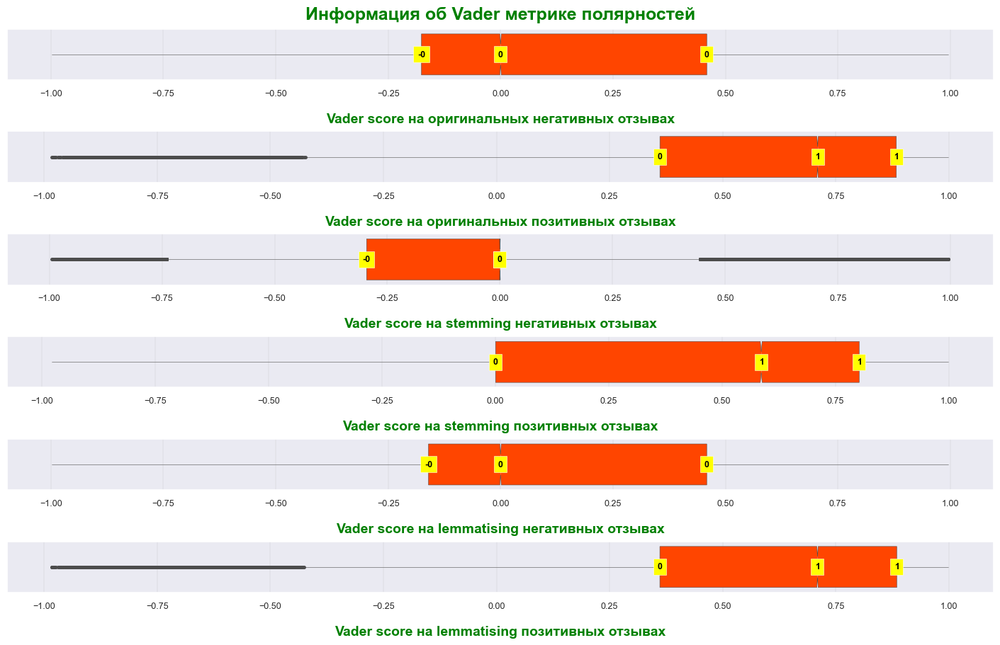

In [123]:
# Vader
figure, (ax1, ax2, ax3, ax4, ax5, ax6) = plt.subplots(6, 1, figsize=(14, 9), constrained_layout=True)
# Выставим тему и стиль для графиков
sns.set_theme(style="whitegrid", palette="pastel")

rc_style={'patch.edgecolor': 'w',
          'grid.color': '.8',
          'grid.linestyle': "-",
          }
sns.set(rc={"grid.linewidth":.3})
sns.set_style("darkgrid",rc_style)

#-------------------------------------------------------------------------
#-------------------------------------------------------------------------

# оригинальные негативные метрики
sns.boxplot(data=df_train,
            x="vader_n_origin_compound",
            notch=True,
            showcaps=False,
            flierprops={"marker": "."},
            boxprops={"facecolor": '#FF4500'},
            medianprops={"color": "coral"},
            linewidth=.4,
            ax = ax1
            );

# вычислим значения квантилей, медианы на графике
q1 = df_train['vader_n_origin_compound'
             ].quantile([.25]).item()
q3 = df_train['vader_n_origin_compound'
             ].quantile([.75]).item()

text_data = [df_train['vader_n_origin_compound'
                     ].median(), 
             q1,
             q3,
            ]

# нанесем значение на график vader_n_origin_compound
for text in text_data:
    ax1.text(text, # медианн
                0, 
                f'{text:.0f}', 
                ha='center', 
                va='center', 
                fontweight='bold', 
                size=9,
                color='black',
                bbox=dict(facecolor='#FFFF00',linewidth = .4))

#-------------------------------------------------------------------------

# оригинальные позитивные метрики
sns.boxplot(data=df_train,
            x="vader_p_origin_compound",
            notch=True,
            showcaps=False,
            flierprops={"marker": "."},
            boxprops={"facecolor": '#FF4500'},
            medianprops={"color": "coral"},
            linewidth=.4,
            ax = ax2
            );

# вычислим значения квантилей, медианы на графике
q1 = df_train['vader_p_origin_compound'
             ].quantile([.25]).item()
q3 = df_train['vader_p_origin_compound'
             ].quantile([.75]).item()

text_data = [df_train['vader_p_origin_compound'
                     ].median(), 
             q1,
             q3,
            ]

# нанесем значение на график vader_p_origin_compound
for text in text_data:
    ax2.text(text, # медианн
                0, 
                f'{text:.0f}', 
                ha='center', 
                va='center', 
                fontweight='bold', 
                size=9,
                color='black',
                bbox=dict(facecolor='#FFFF00',linewidth = .4))

#------------------------------------------------------------------------
#------------------------------------------------------------------------

# stemming негативные метрики
sns.boxplot(data=df_train,
            x="vader_n_stemming_compound",
            notch=True,
            showcaps=False,
            flierprops={"marker": "."},
            boxprops={"facecolor": '#FF4500'},
            medianprops={"color": "coral"},
            linewidth=.4,
            ax = ax3
            );

# вычислим значения квантилей, медианы на графике
q1 = df_train['vader_n_stemming_compound'
             ].quantile([.25]).item()
q3 = df_train['vader_n_stemming_compound'
             ].quantile([.75]).item()

text_data = [df_train['vader_n_stemming_compound'
                     ].median(), 
             q1,
             q3,
            ]

# нанесем значение на график vader_n_stemming_compound
for text in text_data:
    ax3.text(text, # медианн
                0, 
                f'{text:.0f}', 
                ha='center', 
                va='center', 
                fontweight='bold', 
                size=9,
                color='black',
                bbox=dict(facecolor='#FFFF00',linewidth = .4))

#-------------------------------------------------------------------------

# stemming позитивные метрики
sns.boxplot(data=df_train,
            x="vader_p_stemming_compound",
            notch=True,
            showcaps=False,
            flierprops={"marker": "."},
            boxprops={"facecolor": '#FF4500'},
            medianprops={"color": "coral"},
            linewidth=.4,
            ax = ax4
            );

# вычислим значения квантилей, медианы на графике
q1 = df_train['vader_p_stemming_compound'
             ].quantile([.25]).item()
q3 = df_train['vader_p_stemming_compound'
             ].quantile([.75]).item()

text_data = [df_train['vader_p_stemming_compound'
                     ].median(), 
             q1,
             q3,
            ]

# нанесем значение на график vader_p_stemming_compound
for text in text_data:
    ax4.text(text, # медианн
                0, 
                f'{text:.0f}', 
                ha='center', 
                va='center', 
                fontweight='bold', 
                size=9,
                color='black',
                bbox=dict(facecolor='#FFFF00',linewidth = .4))
    
#------------------------------------------------------------------------
#------------------------------------------------------------------------

# stemming негативные метрики
sns.boxplot(data=df_train,
            x="vader_n_lemmatising_compound",
            notch=True,
            showcaps=False,
            flierprops={"marker": "."},
            boxprops={"facecolor": '#FF4500'},
            medianprops={"color": "coral"},
            linewidth=.4,
            ax = ax5
            );

# вычислим значения квантилей, медианы на графике
q1 = df_train['vader_n_lemmatising_compound'
             ].quantile([.25]).item()
q3 = df_train['vader_n_lemmatising_compound'
             ].quantile([.75]).item()

text_data = [df_train['vader_n_lemmatising_compound'
                     ].median(), 
             q1,
             q3,
            ]

# нанесем значение на график vader_n_stemming_compound
for text in text_data:
    ax5.text(text, # медианн
                0, 
                f'{text:.0f}', 
                ha='center', 
                va='center', 
                fontweight='bold', 
                size=9,
                color='black',
                bbox=dict(facecolor='#FFFF00',linewidth = .4))

#-------------------------------------------------------------------------

# stemming позитивные метрики
sns.boxplot(data=df_train,
            x="vader_p_lemmatising_compound",
            notch=True,
            showcaps=False,
            flierprops={"marker": "."},
            boxprops={"facecolor": '#FF4500'},
            medianprops={"color": "coral"},
            linewidth=.4,
            ax = ax6
            );

# вычислим значения квантилей, медианы на графике
q1 = df_train['vader_p_lemmatising_compound'
             ].quantile([.25]).item()
q3 = df_train['vader_p_lemmatising_compound'
             ].quantile([.75]).item()


text_data = [df_train['vader_p_lemmatising_compound'
                     ].median(), 
             q1,
             q3,
            ]

# нанесем значение на график vader_p_stemming_compound
for text in text_data:
    ax6.text(text, # медианн
                0, 
                f'{text:.0f}', 
                ha='center', 
                va='center', 
                fontweight='bold', 
                size=9,
                color='black',
                bbox=dict(facecolor='#FFFF00',linewidth = .4))

#--------------------------------------------------------------------------    
#--------------------------------------------------------------------------

# модефицируем название графика, размеры шрифта и тд.
plt.suptitle('Информация об Vader метрике полярностей',
             size = 18, 
             weight = 600,
             fontdict = {'color' : '#008000'
                        }
            )

# оригинальные негативные метрики
ax1.set_xlabel('Vader score на оригинальных негативных отзывах',
                  fontsize=14,
                  labelpad = 15,
                  fontdict = {'color' : '#008000',
                              'fontweight' : 600}
                 )

ax1.tick_params(axis='both',
                   which='major',
                   labelsize=9
                  )


# оригинальные позитивные метрики
ax2.set_xlabel('Vader score на оригинальных позитивных отзывах',
                  fontsize=14,
                  labelpad = 15,
                  fontdict = {'color' : '#008000',
                              'fontweight' : 600}
                 )

ax2.tick_params(axis='both',
                   which='major',
                   labelsize=9
                  )

#---------------------------------------------------------------------

# stemming негативные метрики
ax3.set_xlabel('Vader score на stemming негативных отзывах',
                  fontsize=14,
                  labelpad = 15,
                  fontdict = {'color' : '#008000',
                              'fontweight' : 600}
                 )

ax3.tick_params(axis='both',
                   which='major',
                   labelsize=9
                  )


# stemming позитивные метрики
ax4.set_xlabel('Vader score на stemming позитивных отзывах',
                  fontsize=14,
                  labelpad = 15,
                  fontdict = {'color' : '#008000',
                              'fontweight' : 600}
                 )

ax4.tick_params(axis='both',
                   which='major',
                   labelsize=9
                  )

#------------------------------------------------------------------------

# stemming негативные метрики
ax5.set_xlabel('Vader score на lemmatising негативных отзывах',
                  fontsize=14,
                  labelpad = 15,
                  fontdict = {'color' : '#008000',
                              'fontweight' : 600}
                 )

ax5.tick_params(axis='both',
                   which='major',
                   labelsize=9
                  )


# stemming позитивные метрики
ax6.set_xlabel('Vader score на lemmatising позитивных отзывах',
                  fontsize=14,
                  labelpad = 15,
                  fontdict = {'color' : '#008000',
                              'fontweight' : 600}
                 )

ax6.tick_params(axis='both',
                   which='major',
                   labelsize=9
                  )

<hr style="border-style: dashed;">

<span style="color:#D2691E">
    
Здесь мы видим, что Vader делает оценку от -1 до 1, в то время как Afinn более широкую оценку применяет. Также мы можем заметить что благодаря четко фиксированной системе координат мы можем более 'адекватно' сравнивать графики. 
    
<hr style="border-style: dashed;">

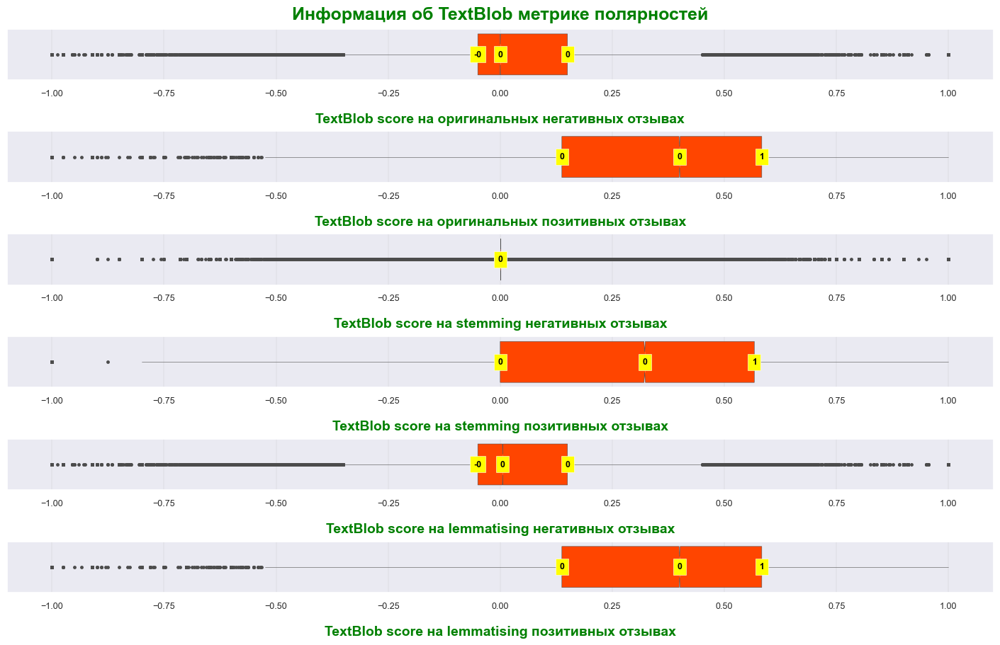

In [124]:
# TextBlob
figure, (ax1, ax2, ax3, ax4, ax5, ax6) = plt.subplots(6, 1, figsize=(14, 9), constrained_layout=True)
# Выставим тему и стиль для графиков
sns.set_theme(style="whitegrid", palette="pastel")

rc_style={'patch.edgecolor': 'w',
          'grid.color': '.8',
          'grid.linestyle': "-",
          }
sns.set(rc={"grid.linewidth":.3})
sns.set_style("darkgrid",rc_style)

#-------------------------------------------------------------------------
#-------------------------------------------------------------------------

# оригинальные негативные метрики
sns.boxplot(data=df_train,
            x="tb_n_origin_polarity",
            notch=True,
            showcaps=False,
            flierprops={"marker": "."},
            boxprops={"facecolor": '#FF4500'},
            medianprops={"color": "coral"},
            linewidth=.4,
            ax = ax1
            );

# вычислим значения квантилей, медианы на графике
q1 = df_train['tb_n_origin_polarity'
             ].quantile([.25]).item()
q3 = df_train['tb_n_origin_polarity'
             ].quantile([.75]).item()

text_data = [df_train['tb_n_origin_polarity'
                     ].median(), 
             q1,
             q3,
            ]

# нанесем значение на график vader_n_origin_compound
for text in text_data:
    ax1.text(text, # медианн
                0, 
                f'{text:.0f}', 
                ha='center', 
                va='center', 
                fontweight='bold', 
                size=9,
                color='black',
                bbox=dict(facecolor='#FFFF00',linewidth = .4))

#-------------------------------------------------------------------------

# оригинальные позитивные метрики
sns.boxplot(data=df_train,
            x="tb_p_origin_polarity",
            notch=True,
            showcaps=False,
            flierprops={"marker": "."},
            boxprops={"facecolor": '#FF4500'},
            medianprops={"color": "coral"},
            linewidth=.4,
            ax = ax2
            );

# вычислим значения квантилей, медианы на графике
q1 = df_train['tb_p_origin_polarity'
             ].quantile([.25]).item()
q3 = df_train['tb_p_origin_polarity'
             ].quantile([.75]).item()

text_data = [df_train['tb_p_origin_polarity'
                     ].median(), 
             q1,
             q3,
            ]

# нанесем значение на график vader_p_origin_compound
for text in text_data:
    ax2.text(text, # медианн
                0, 
                f'{text:.0f}', 
                ha='center', 
                va='center', 
                fontweight='bold', 
                size=9,
                color='black',
                bbox=dict(facecolor='#FFFF00',linewidth = .4))

#------------------------------------------------------------------------
#------------------------------------------------------------------------

# stemming негативные метрики
sns.boxplot(data=df_train,
            x="tb_n_stemming_polarity",
            notch=True,
            showcaps=False,
            flierprops={"marker": "."},
            boxprops={"facecolor": '#FF4500'},
            medianprops={"color": "coral"},
            linewidth=.4,
            ax = ax3
            );

# вычислим значения квантилей, медианы на графике
q1 = df_train['tb_n_stemming_polarity'
             ].quantile([.25]).item()
q3 = df_train['tb_n_stemming_polarity'
             ].quantile([.75]).item()

text_data = [df_train['tb_n_stemming_polarity'
                     ].median(), 
             q1,
             q3,
            ]

# нанесем значение на график vader_n_stemming_compound
for text in text_data:
    ax3.text(text, # медианн
                0, 
                f'{text:.0f}', 
                ha='center', 
                va='center', 
                fontweight='bold', 
                size=9,
                color='black',
                bbox=dict(facecolor='#FFFF00',linewidth = .4))

#-------------------------------------------------------------------------

# stemming позитивные метрики
sns.boxplot(data=df_train,
            x="tb_p_stemming_polarity",
            notch=True,
            showcaps=False,
            flierprops={"marker": "."},
            boxprops={"facecolor": '#FF4500'},
            medianprops={"color": "coral"},
            linewidth=.4,
            ax = ax4
            );

# вычислим значения квантилей, медианы на графике
q1 = df_train['tb_p_stemming_polarity'
             ].quantile([.25]).item()
q3 = df_train['tb_p_stemming_polarity'
             ].quantile([.75]).item()

text_data = [df_train['tb_p_stemming_polarity'
                     ].median(), 
             q1,
             q3,
            ]

# нанесем значение на график vader_p_stemming_compound
for text in text_data:
    ax4.text(text, # медианн
                0, 
                f'{text:.0f}', 
                ha='center', 
                va='center', 
                fontweight='bold', 
                size=9,
                color='black',
                bbox=dict(facecolor='#FFFF00',linewidth = .4))
    
#------------------------------------------------------------------------
#------------------------------------------------------------------------

# lemmatising негативные метрики
sns.boxplot(data=df_train,
            x="tb_n_lemmatising_polarity",
            notch=True,
            showcaps=False,
            flierprops={"marker": "."},
            boxprops={"facecolor": '#FF4500'},
            medianprops={"color": "coral"},
            linewidth=.4,
            ax = ax5
            );

# вычислим значения квантилей, медианы на графике
q1 = df_train['tb_n_lemmatising_polarity'
             ].quantile([.25]).item()
q3 = df_train['tb_n_lemmatising_polarity'
             ].quantile([.75]).item()

text_data = [df_train['tb_n_lemmatising_polarity'
                     ].median(), 
             q1,
             q3,
            ]

# нанесем значение на график vader_n_stemming_compound
for text in text_data:
    ax5.text(text, # медианн
                0, 
                f'{text:.0f}', 
                ha='center', 
                va='center', 
                fontweight='bold', 
                size=9,
                color='black',
                bbox=dict(facecolor='#FFFF00',linewidth = .4))

#-------------------------------------------------------------------------

# lemmatising позитивные метрики
sns.boxplot(data=df_train,
            x="tb_p_lemmatising_polarity",
            notch=True,
            showcaps=False,
            flierprops={"marker": "."},
            boxprops={"facecolor": '#FF4500'},
            medianprops={"color": "coral"},
            linewidth=.4,
            ax = ax6
            );

# вычислим значения квантилей, медианы на графике
q1 = df_train['tb_p_lemmatising_polarity'
             ].quantile([.25]).item()
q3 = df_train['tb_p_lemmatising_polarity'
             ].quantile([.75]).item()


text_data = [df_train['tb_p_lemmatising_polarity'
                     ].median(), 
             q1,
             q3,
            ]

# нанесем значение на график vader_p_stemming_compound
for text in text_data:
    ax6.text(text, # медианн
                0, 
                f'{text:.0f}', 
                ha='center', 
                va='center', 
                fontweight='bold', 
                size=9,
                color='black',
                bbox=dict(facecolor='#FFFF00',linewidth = .4))

#--------------------------------------------------------------------------    
#--------------------------------------------------------------------------

# модефицируем название графика, размеры шрифта и тд.
plt.suptitle('Информация об TextBlob метрике полярностей',
             size = 18, 
             weight = 600,
             fontdict = {'color' : '#008000'
                        }
            )

# оригинальные негативные метрики
ax1.set_xlabel('TextBlob score на оригинальных негативных отзывах',
                  fontsize=14,
                  labelpad = 15,
                  fontdict = {'color' : '#008000',
                              'fontweight' : 600}
                 )

ax1.tick_params(axis='both',
                   which='major',
                   labelsize=9
                  )


# оригинальные позитивные метрики
ax2.set_xlabel('TextBlob score на оригинальных позитивных отзывах',
                  fontsize=14,
                  labelpad = 15,
                  fontdict = {'color' : '#008000',
                              'fontweight' : 600}
                 )

ax2.tick_params(axis='both',
                   which='major',
                   labelsize=9
                  )

#---------------------------------------------------------------------

# stemming негативные метрики
ax3.set_xlabel('TextBlob score на stemming негативных отзывах',
                  fontsize=14,
                  labelpad = 15,
                  fontdict = {'color' : '#008000',
                              'fontweight' : 600}
                 )

ax3.tick_params(axis='both',
                   which='major',
                   labelsize=9
                  )


# stemming позитивные метрики
ax4.set_xlabel('TextBlob score на stemming позитивных отзывах',
                  fontsize=14,
                  labelpad = 15,
                  fontdict = {'color' : '#008000',
                              'fontweight' : 600}
                 )

ax4.tick_params(axis='both',
                   which='major',
                   labelsize=9
                  )

#------------------------------------------------------------------------

# stemming негативные метрики
ax5.set_xlabel('TextBlob score на lemmatising негативных отзывах',
                  fontsize=14,
                  labelpad = 15,
                  fontdict = {'color' : '#008000',
                              'fontweight' : 600}
                 )

ax5.tick_params(axis='both',
                   which='major',
                   labelsize=9
                  )


# stemming позитивные метрики
ax6.set_xlabel('TextBlob score на lemmatising позитивных отзывах',
                  fontsize=14,
                  labelpad = 15,
                  fontdict = {'color' : '#008000',
                              'fontweight' : 600}
                 )

ax6.tick_params(axis='both',
                   which='major',
                   labelsize=9
                  )

<hr style="border-style: dashed;">

<span style="color:#D2691E">
    
Здесь из общей тенденций выбиваются только негативные отзывы подвергшиеся стеммингу (нахождения основы слова).
    
<hr style="border-style: dashed;">

In [125]:
# посмотрим отсортированные отзывы
display(df_train['negative_review'].value_counts().head())
display(df_train['positive_review'].value_counts().head())

no negative    95907
nothing        15882
n a             1392
none            1115
neutral          606
Name: negative_review, dtype: int64

no positive       26885
location           8843
everything         2453
nothing            1297
great location     1291
Name: positive_review, dtype: int64

In [126]:
# создаем частотный словарь, для поиска слов в регулярных выражениях
tokenized_texts_negative = df_train['negative_review_tokens'].tolist()
tokenized_texts_positive = df_train['positive_review_tokens'].tolist()

# негативные
wordfreq={}
for ls in tokenized_texts_negative:
    for token in ls:
        if token not in wordfreq.keys():
            wordfreq[token] = 1
        else:
            wordfreq[token] += 1

# сортируем словарь
negative_wordfreq = sorted(wordfreq.items(), key=lambda item: item[
                                                        1], reverse=True)

# позитивные
wordfreq={}
for ls in tokenized_texts_positive:
    for token in ls:
        if token not in wordfreq.keys():
            wordfreq[token] = 1
        else:
            wordfreq[token] += 1

# сортируем словарь
positive_wordfreq = sorted(wordfreq.items(), key=lambda item: item[
                                                        1], reverse=True)

display(negative_wordfreq[:10])
display(positive_wordfreq[:10])

[('the', 398224),
 ('was', 177329),
 ('a', 172606),
 ('to', 171723),
 ('and', 164247),
 ('no', 148337),
 ('room', 132025),
 ('in', 126328),
 ('negative', 97092),
 ('not', 94357)]

[('the', 385786),
 ('and', 315806),
 ('was', 177066),
 ('staff', 145874),
 ('location', 144568),
 ('very', 144568),
 ('to', 140847),
 ('a', 123588),
 ('room', 105728),
 ('hotel', 94000)]

<hr style="border-style: dashed;">

<span style="color:#D2691E">
После анализа я выделил некоторые отзывы которые в отдельном столбце проиндексирую 0 - это будут либо нейтральные либо позитивные отзывы, а оставшиеся отзывы будут негативными (1). В позитивных отзывах нейтральных и негативных намного меньше, чем в негативных нейтральных и позитивных.
    
<hr style="border-style: dashed;">

In [127]:
# отзывы которые я буду использовать для того чтобы проставить 0
ls_negative = ['no negative', 'nothing', 'n a', 'none', 'neutral', 
             'nothing really', 'all good', 'no complaints', 
             'nothing to dislike', 'na', 'everything was perfect', 'no']
ls_positive = ['no positive', 'neutral']

In [128]:
# разметим данные
df_train['negative_evaluation'] = df_train['negative_review'].apply(lambda x: 0 if x in ls_negative else 1) 
df_train['positive_evaluation'] = df_train['positive_review'].apply(lambda x: 0 if x in ls_positive else 1)

df_test['negative_evaluation'] = df_test['negative_review'].apply(lambda x: 0 if x in ls_negative else 1) 
df_test['positive_evaluation'] = df_test['positive_review'].apply(lambda x: 0 if x in ls_positive else 1)

<span style="color:#D2691E">
    
### 2.6 tags - теги, которые рецензент дал отелю

In [129]:
# превратим данные в список
df_train['tags'] = df_train['tags'].apply(lambda x: x[2:-2])
df_train['tags'] = df_train['tags'].apply(lambda x: x.strip().split(' \', \' '))

df_test['tags'] = df_test['tags'].apply(lambda x: x[2:-2])
df_test['tags'] = df_test['tags'].apply(lambda x: x.strip().split(' \', \' '))

In [130]:
# Посмотрим топ тегов
tags = df_train['tags'].explode()
print(f'Количество уникальных значений {len(tags.value_counts())}')
display(tags.value_counts().head(10))

Количество уникальных значений 2368


Leisure trip                      313593
Submitted from a mobile device    230778
Couple                            189212
Stayed 1 night                    145373
Stayed 2 nights                   100263
Solo traveler                      81235
Stayed 3 nights                    72000
Business trip                      61989
Group                              49088
Family with young children         45836
Name: tags, dtype: int64

In [131]:
# топ 50 тэгов
display(tags.value_counts().head(50))

Leisure trip                      313593
Submitted from a mobile device    230778
Couple                            189212
Stayed 1 night                    145373
Stayed 2 nights                   100263
Solo traveler                      81235
Stayed 3 nights                    72000
Business trip                      61989
Group                              49088
Family with young children         45836
Stayed 4 nights                    35748
Double Room                        26386
Standard Double Room               24151
Superior Double Room               23550
Family with older children         19802
Deluxe Double Room                 18623
Double or Twin Room                16824
Stayed 5 nights                    15611
Standard Double or Twin Room       13062
Classic Double Room                12716
Superior Double or Twin Room       10238
2 rooms                             9287
Stayed 6 nights                     7399
Standard Twin Room                  7325
Single Room     

<hr style="border-style: dashed;">

<span style="color:#D2691E">

После изучения тегов мы можем видеть, что у нас есть некоторая информация:  
- поезда на отдых (Leisure trip ) - поезда по работе (Business trip)
- отправленно с мобильного устройства (Submitted from a mobile device) - отправленно не с мобильного (видимо ?)
- Пара (Couple) - Одиночка (Solo traveler) - Группа (Group)
- Семья с детьми (Family with young children, Family with older children) - Семьи без детей (либо без указания, что с детьми)
- 1 ночь в отеле - 2 ночи в отеле - 3 ночи в отеле - 4 ночи в отеле - 5 ночей в отеле (далее не имеет смысла, т.к там меньше 3% упоминания в датасете)
- Также посмотрим количество тэгов, которые проставили рецензенты

<hr style="border-style: dashed;">
    
- дальше идут номера, но здесь есть своя специфика - так как в Лондоне своя система стандартов для отелей, на континенте своя (Французская), ну и есть специфка от региона к региону.
- также я не смотрел ниже топ 50, так-как слишком незначительно будет влияние этих данных (меньше 3% от датасета)
    
<hr style="border-style: dashed;">

In [132]:
# отметим данные по типу путешествия
df_train['type_trip'] = df_train['tags'].apply(lambda x: 'leisure_trip' if \
    'Leisure trip' in x else 'business_trip' if 'Business trip' in x else 'unmarked_trip')

df_test['type_trip'] = df_test['tags'].apply(lambda x: 'leisure_trip' if \
    'Leisure trip' in x else 'business_trip' if 'Business trip' in x else 'unmarked_trip')

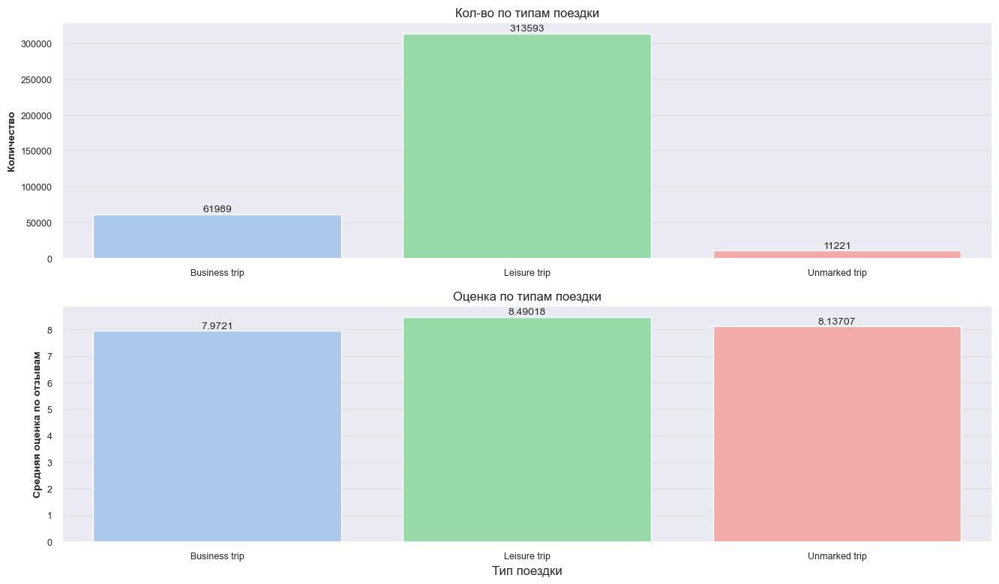

In [133]:
# посмотрим оценку в зависимости от того какой тип путешествия был
sns.set_palette("pastel6")
# график
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(16, 9), linewidth = .4)

xticklabels_guest = ["Business trip", "Leisure trip", "Unmarked trip"]
trips = df_train.groupby('type_trip')['reviewer_score'].count()
sns.barplot(x=trips.index, y=trips.values, ax=ax1).set(title='Кол-во по типам поездки');
ax1.set_ylabel('Количество', fontweight='bold', fontsize=10)
ax1.set_xticklabels(xticklabels_guest, fontsize = 10)
ax1.set_xlabel('')
ax1.bar_label(ax1.containers[0], fontsize=10);
ax1.tick_params(axis='both', which='major', labelsize=9)


# настройка графика средней оценки и типа путешествия
trips = df_train.groupby('type_trip')['reviewer_score'].mean()
sns.barplot(x=trips.index, y=trips.values, ax=ax2).set(title='Оценка по типам поездки');
ax2.set_ylabel('Средняя оценка по отзывам', fontweight='bold', fontsize=10)
ax2.set_xticklabels(xticklabels_guest, fontsize = 10)
ax2.set_xlabel('Тип поездки')
ax2.bar_label(ax2.containers[0], fontsize=10);
ax2.tick_params(axis='both', which='major', labelsize=9)

In [169]:
# закодируем параметр type_trip
one_hot = pd.get_dummies(df_train['type_trip'])
one_hot_t = pd.get_dummies(df_test['type_trip'])

# присоединим данные к датафрейму
df_train = df_train.join(one_hot, lsuffix='left', rsuffix='right')
df_test = df_test.join(one_hot_t)

<hr style="border-style: dashed;">

<span style="color:#D2691E">
Из графика видно, что те кто останавливается в отелях по работе и пишет отзывы, ставит более низкие оценки. В то время когда те кто путешествует на отдыхе, находят время ставить отзывы и ставят более высокие оценки. Также те кто не отметил у скебя тип путешествия где то посередине между этими типами.
    
<hr style="border-style: dashed;">

In [171]:
# способ отправления отзыва
df_train['type_submitted'] = df_train['tags'].apply(lambda x: 'mobile submitted' if \
    'Submitted from a mobile device' in x else 'unmarked submitted')

df_test['type_submitted'] = df_test['tags'].apply(lambda x: 'mobile submitted' if \
    'Submitted from a mobile device' in x else 'unmarked submitted')

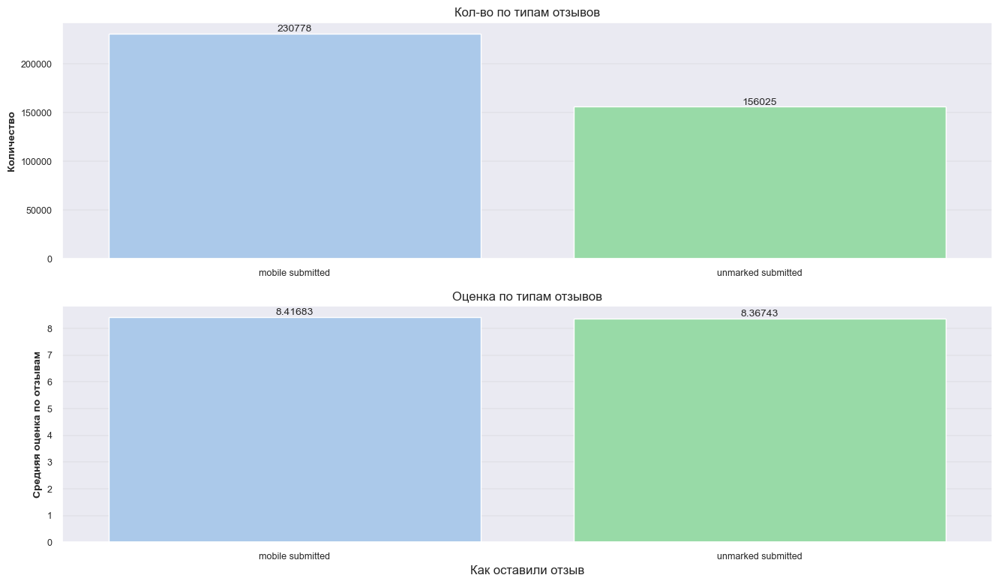

In [172]:
# посмотрим оценку в зависимости от того как оставили отзыв
sns.set_palette("pastel6")
# график
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(16, 9), linewidth = .4)

# настройка графика количество в зависимости от того как оставили отзыв
submitted_count = df_train.groupby('type_submitted')['reviewer_score'].count()
sns.barplot(x=submitted_count.index, y=submitted_count.values, ax=ax1).set(
    title='Кол-во по типам отзывов');
ax1.set_ylabel('Количество', fontweight='bold', fontsize=10)
ax1.set_xlabel('')
ax1.bar_label(ax1.containers[0], fontsize=10);
ax1.tick_params(axis='both', which='major', labelsize=9)

# настройка графика средней оценки в зависимости от того как оставили отзыв
submitted_count = df_train.groupby('type_submitted')['reviewer_score'].mean()
sns.barplot(x=submitted_count.index, y=submitted_count.values, ax=ax2).set(
    title='Оценка по типам отзывов');
ax2.set_ylabel('Средняя оценка по отзывам', fontweight='bold', fontsize=10)
ax2.set_xlabel('Как оставили отзыв')
ax2.bar_label(ax2.containers[0], fontsize=10);
ax2.tick_params(axis='both', which='major', labelsize=9)

In [173]:
# закодируем параметр type_submitted
one_hot = pd.get_dummies(df_train['type_submitted'])
one_hot_t = pd.get_dummies(df_test['type_submitted'])

# присоединим данные к датафрейму
df_train = df_train.join(one_hot)
df_test = df_test.join(one_hot_t)

<hr style="border-style: dashed;">

<span style="color:#D2691E">
Большую часть отзывов оставили с мобильных устройств. Те кто не маркировал с какого устройства был отправленн отзыв ставили более низкую оценку, чем с мобильных устройств.
    
<hr style="border-style: dashed;">

In [174]:
# С кем было путешествие
df_train['neighbor_trip'] = df_train['tags'].apply(lambda x: 'couple' if \
    'Couple' in x else 'solo traveler' if 'Solo traveler' in x else 'group' if \
                                        'Group' in x else 'unmarked neighbor')

df_test['neighbor_trip'] = df_test['tags'].apply(lambda x: 'couple' if \
    'Couple' in x else 'solo traveler' if 'Solo traveler' in x else 'group' if \
                                        'Group' in x else 'unmarked neighbor')

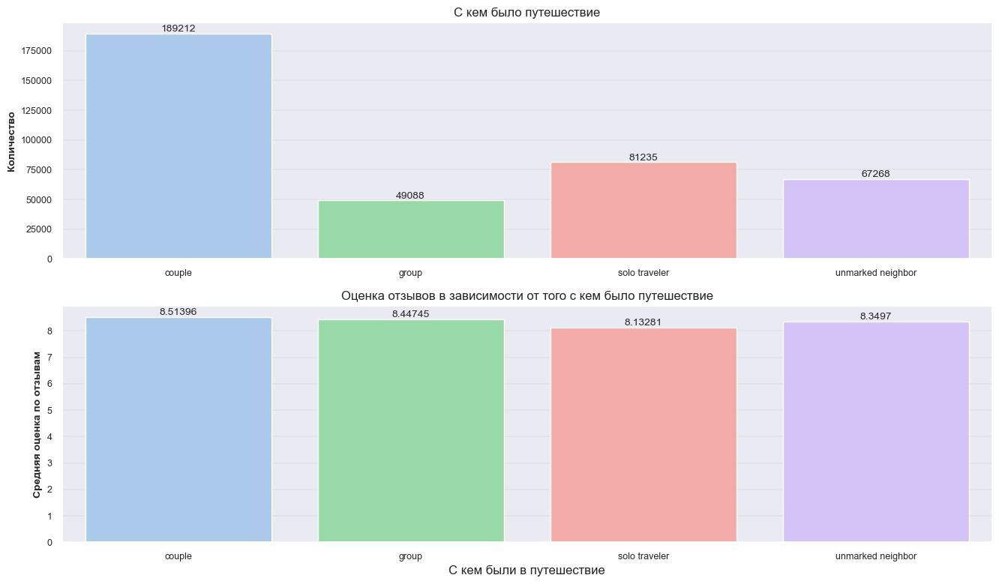

In [175]:
# посмотрим количество и оценку в зависимости от как совершалось путешествие
sns.set_palette("pastel6")
# график
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(16, 9), linewidth = .4)

# настройка графика количество в зависимости от того как оставили отзыв
neighbor = df_train.groupby('neighbor_trip')['reviewer_score'].count()
sns.barplot(x=neighbor.index, y=neighbor.values, ax=ax1).set(
    title='C кем было путешествие');
ax1.set_ylabel('Количество', fontweight='bold', fontsize=10)
ax1.set_xlabel('')
ax1.bar_label(ax1.containers[0], fontsize=10);
ax1.tick_params(axis='both', which='major', labelsize=9)

# настройка графика средней оценки в зависимости от того как оставили отзыв
neighbor = df_train.groupby('neighbor_trip')['reviewer_score'].mean()
sns.barplot(x=neighbor.index, y=neighbor.values, ax=ax2).set(
    title='Оценка отзывов в зависимости от того с кем было путешествие');
ax2.set_ylabel('Средняя оценка по отзывам', fontweight='bold', fontsize=10)
ax2.set_xlabel('С кем были в путешествие')
ax2.bar_label(ax2.containers[0], fontsize=10);
ax2.tick_params(axis='both', which='major', labelsize=9)

In [176]:
# закодируем параметр neighbor_trip
one_hot = pd.get_dummies(df_train['neighbor_trip'])
one_hot_t = pd.get_dummies(df_test['neighbor_trip'])

# присоединим данные к датафрейму
df_train = df_train.join(one_hot)
df_test = df_test.join(one_hot_t)

<hr style="border-style: dashed;">

<span style="color:#D2691E">

Наиболее часто путешествуют парами (Couple), на втором месте одиночки (Solo traveler), затем идут те кто не отметился (unmarked neighbor) и далее группы (Group). По оценкам мы видим, что самые низкие оценки это у путешествиников соло, затем выше оценка у не промаркированных и групп, а самые высокие у пар. Возможно большая часть одиноек это как раз рабоие поездки.
    
<hr style="border-style: dashed;">

In [177]:
# Поездка с детьми или без
df_train['children_trip'] = df_train['tags'].apply(lambda x: 'young children' if \
'Family with young children' in x else 'older children' if \
'Family with older children' in x else 'unmarked children')

df_test['children_trip'] = df_test['tags'].apply(lambda x: 'young children' if \
'Family with young children' in x else 'older children' if \
'Family with older children' in x else 'unmarked children')

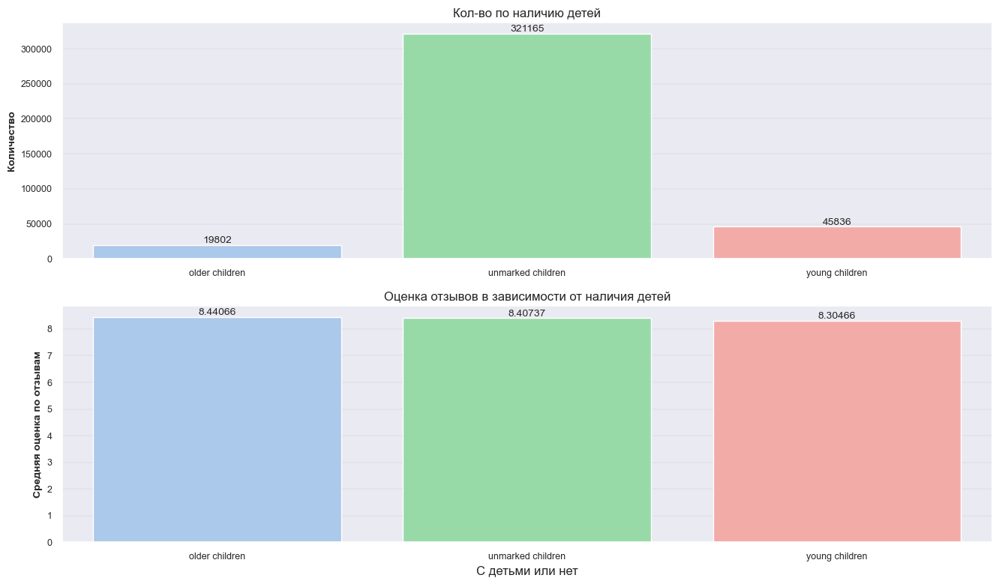

In [178]:
# посмотрим количество и оценку в зависимости от наличия детей
sns.set_palette("pastel6")
# график
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(16, 9), linewidth = .4)

# настройка графика количество в зависимости от того как оставили отзыв
children = df_train.groupby('children_trip')['reviewer_score'].count()
sns.barplot(x=children.index, y=children.values, ax=ax1).set(
    title='Кол-во по наличию детей');
ax1.set_ylabel('Количество', fontweight='bold', fontsize=10)
ax1.set_xlabel('')
ax1.bar_label(ax1.containers[0], fontsize=10);
ax1.tick_params(axis='both', which='major', labelsize=9)

# настройка графика средней оценки в зависимости от того как оставили отзыв
children = df_train.groupby('children_trip')['reviewer_score'].mean()
sns.barplot(x=children.index, y=children.values, ax=ax2).set(
    title='Оценка отзывов в зависимости от наличия детей');
ax2.set_ylabel('Средняя оценка по отзывам', fontweight='bold', fontsize=10)
ax2.set_xlabel('С детьми или нет')
ax2.bar_label(ax2.containers[0], fontsize=10);
ax2.tick_params(axis='both', which='major', labelsize=9)

In [179]:
# закодируем параметр children_trip
one_hot = pd.get_dummies(df_train['children_trip'])
one_hot_t = pd.get_dummies(df_test['children_trip'])

# присоединим данные к датафрейму
df_train = df_train.join(one_hot)
df_test = df_test.join(one_hot_t)

<hr style="border-style: dashed;">

<span style="color:#D2691E">

Подавляющее большинство путешествует без детей или не отмечает их наличие. Самая низкая оценку ставят те, кто имеет маленьких детей (young children), возможно отели не слишком приспособленны для обслуживания маленьких детей. Чуть повыше оценка у тех кого отсутствуют дети, и самая высокая оценка у тех кто путешествует с более взрослыми детьми (подростки ?). Видимо их запросы отель уже может удовлетворить. Могу предположить, что скорее всего данный признак будет не сильно влиять на модель.

<hr style="border-style: dashed;">

In [180]:

df_train['night_in_hotel'] = df_train['tags'].apply(lambda x: night_in_hotel(x))

df_test['night_in_hotel'] = df_test['tags'].apply(lambda x: night_in_hotel(x))

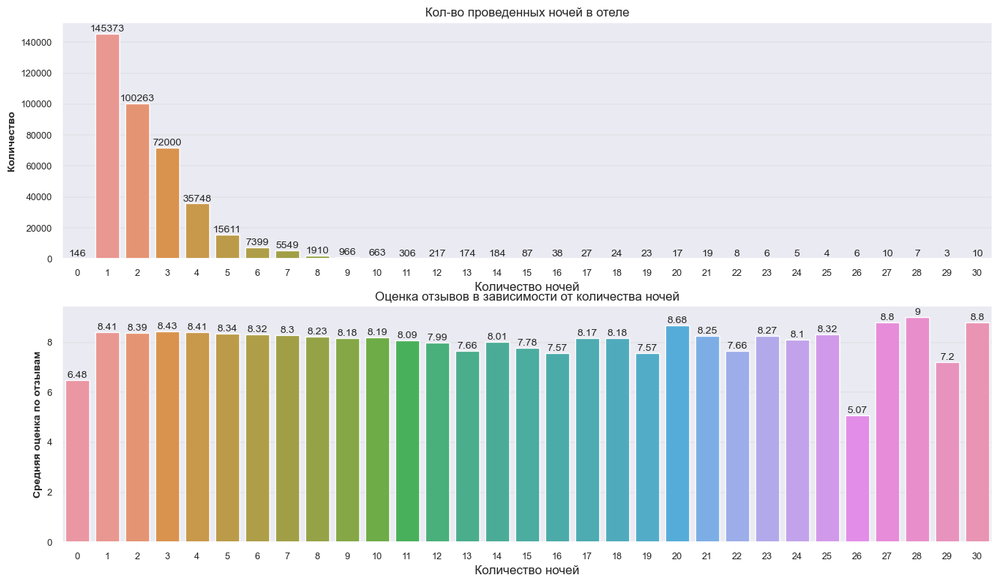

In [181]:
# посмотрим количество и оценку в зависимости от проведенных ночей
sns.set_palette("Set2")
# график
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(16, 9), linewidth = 1)

# настройка графика количество в зависимости от количества ночей
night = df_train.groupby('night_in_hotel')['reviewer_score'].count().reset_index()
night['night_in_hotel'] = night['night_in_hotel'].astype('int8') 
night['night_in_hotel'] = pd.to_timedelta(night['night_in_hotel'], unit='d').dt.days

sns.barplot(x=night['night_in_hotel'], y=night['reviewer_score'], ax=ax1).set(
    title='Кол-во проведенных ночей в отеле');

ax1.set_ylabel('Количество', fontweight='bold', fontsize=10)
ax1.set_xlabel('Количество ночей')
ax1.bar_label(ax1.containers[0], fontsize=10);
ax1.tick_params(axis='both', which='major', labelsize=9)

# настройка графика средней оценки в зависимости от количества ночей
night = df_train.groupby('night_in_hotel')['reviewer_score'].mean().round(2).reset_index()
night['night_in_hotel'] = night['night_in_hotel'].astype('int8') 
night['night_in_hotel'] = pd.to_timedelta(night['night_in_hotel'], unit='d').dt.days

sns.barplot(x=night['night_in_hotel'], y=night['reviewer_score'], ax=ax2).set(
    title='Оценка отзывов в зависимости от количества ночей');
ax2.set_ylabel('Средняя оценка по отзывам', fontweight='bold', fontsize=10)
ax2.set_xlabel('Количество ночей')
ax2.bar_label(ax2.containers[0], fontsize=10);
ax2.tick_params(axis='both', which='major', labelsize=9)

In [182]:
# закодируем параметр night_in_hotel
df_train['night_in_hotel'] = df_train['night_in_hotel'].apply(
    lambda x: 6 if (x > 5) or (x == 0) else x)

df_test['night_in_hotel'] = df_test['night_in_hotel'].apply(
    lambda x: 6 if (x > 5) or (x == 0) else x)

In [183]:
# закодируем данные
one_hot = pd.get_dummies(df_train['night_in_hotel'], prefix='night_')
one_hot_t= pd.get_dummies(df_test['night_in_hotel'], prefix='night_')

# присоединим данные к датафрейму
df_train = df_train.join(one_hot)
df_test = df_test.join(one_hot_t)

# удалим столбец 
df_train.drop('night_in_hotel', axis=1, inplace=True)
df_test.drop('night_in_hotel', axis=1, inplace=True)

<hr style="border-style: dashed;">

<span style="color:#D2691E">

Как я и говорил ранее больше 5 ночей не имеет смысла смотреть, так как дальше количество отдыхающих становится меньше 3% от датасета, и так все что больше 5 ночей мы поместим в 6 ночей. Также у нас есть 146 рецензентов которые не указали сколько ночей они останавливались и возможно по достаточно низкой оценки мы можем предположить, что они действительно везжали оттуда без ночевки (эту категорию мы тоже переместим в 6 ночей).   
ЧТо касается оценки, то мы видим, что чем больше ночей тем ниже оценка, возможно начинает накапливатся усталось или подмечаются недочеты в отеле ? А если обратим внимание на оценки от 6 ночей и больше, то увидим что за счет малого количества постояльцев на этом отрезке, оценка начинает скакать.
    
<hr style="border-style: dashed;">

In [184]:
# количество тэгов которые проставили рецензенты
df_train['count_tags'] = df_train['tags'].apply(lambda x: len(x))
df_test['count_tags'] = df_test['tags'].apply(lambda x: len(x))

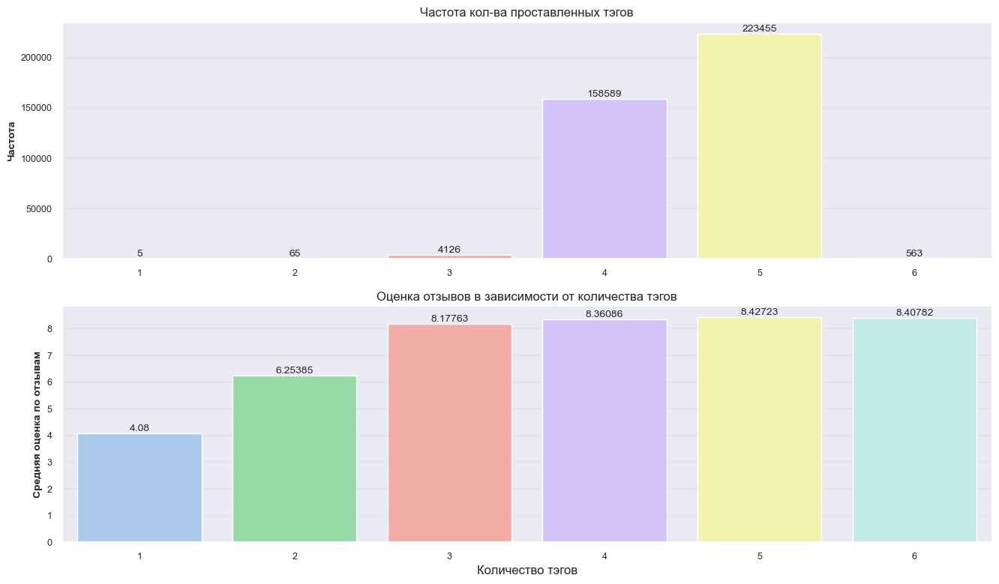

In [185]:
# посмотрим количество и оценку в зависимости от тэгов
sns.set_palette("pastel6")
# график
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(16, 9), linewidth = 1)

# настройка графика частоты в зависимости от количества тэгов
tags = df_train.groupby('count_tags')['reviewer_score'].count()

sns.barplot(x=tags.index, y=tags.values, ax=ax1).set(
    title='Частота кол-ва проставленных тэгов');

ax1.set_ylabel('Частота', fontweight='bold', fontsize=10)
ax1.set_xlabel('')
ax1.bar_label(ax1.containers[0], fontsize=10);
ax1.tick_params(axis='both', which='major', labelsize=9)

# настройка графика средней оценки в зависимости от количества тэгов
tags = df_train.groupby('count_tags')['reviewer_score'].mean()

sns.barplot(x=tags.index, y=tags.values, ax=ax2).set(
    title='Оценка отзывов в зависимости от количества тэгов');
ax2.set_ylabel('Средняя оценка по отзывам', fontweight='bold', fontsize=10)
ax2.set_xlabel('Количество тэгов')
ax2.bar_label(ax2.containers[0], fontsize=10);
ax2.tick_params(axis='both', which='major', labelsize=9)

In [186]:
# закодируем параметр count_tags
one_hot = pd.get_dummies(df_train['count_tags'], prefix='count_tags_')
one_hot_t = pd.get_dummies(df_test['count_tags'], prefix='count_tags_')

# присоединим данные к датафрейму
df_train = df_train.join(one_hot)
df_test = df_test.join(one_hot_t)

# удалим столбец 
df_train.drop('count_tags', axis=1, inplace=True)
df_test.drop('count_tags', axis=1, inplace=True)

<hr style="border-style: dashed;">

<span style="color:#D2691E">

По количеству большая часть ставит 4-5 тэгов, затем идут 3 тэга, 6 тэгов и очень редко 1 и 2 тэга. Те кто ставит 1-2 тэга ставят низкие оценки, возможно потому что не нашли в отеле какие то плюсы ?. От 3 до 6 тэгов уже более высокие оценки в диапозоне от 8 до 8.5. Здесь люди более основательно видимо подошли и нашли плюсы и минусы отеля и смогли поставить оценку основываясь на этом. 
    
<hr style="border-style: dashed;">

In [187]:
df_train.shape

(386803, 123)

<hr style="border-style: dashed;">

<span style="color:#D2691E">

Работу по проектированию признаков мы закончили, в общем и целом забегая немного вперед скажу, что самый большой вес в модели имееют парметры связанные с оценкой полярности. И чем более подробный/длинный текст в отзыве тем точнее мы можем определить мнение рецензента. 
    
<hr style="border-style: dashed;">

## <center> 3. Отбор признаков 


In [211]:
# посмотрим на признаки
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 386803 entries, 0 to 386802
Columns: 123 entries, hotel_address to count_tags__6
dtypes: datetime64[ns](1), float64(47), int64(21), object(24), uint8(30)
memory usage: 285.5+ MB


<hr style="border-style: dashed;">

<span style="color:#D2691E">

После всех манипуляций у нас 123 столбца: 
- datetime64\[ns\](1) 
- float64(47) 
- int64(21)
- object(24) 
- uint8(30)

Посмотрим параметры - object, datetime64, так как они нам в модели не понадобяться и мы их будем удалять.
    
<hr style="border-style: dashed;">

In [218]:
object_columns = [s for s in df_train.columns if df_train[s
            ].dtypes == 'object' or df_train[s].dtypes == 'datetime64[ns]']
display(object_columns)

['hotel_address',
 'review_date',
 'hotel_name',
 'reviewer_nationality',
 'negative_review',
 'positive_review',
 'tags',
 'country',
 'city',
 'centre_city',
 'acronym_hotel',
 'negative_review_tokens',
 'positive_review_tokens',
 'negative_review_stemming',
 'positive_review_stemming',
 'negative_review_lemmatising',
 'positive_review_lemmatising',
 'negative_review_stemming_str',
 'negative_review_lemmatising_str',
 'positive_review_stemming_str',
 'positive_review_lemmatising_str',
 'type_trip',
 'type_submitted',
 'neighbor_trip',
 'children_trip']

<hr style="border-style: dashed;">

<span style="color:#D2691E">

Всего 25 параметров, с какими то мы поработали, какие-то создали и тоже у с ними поработали. также помимо этих данных нам надо будет удалить следующие столбцы - которые для нас не будут нести какую либо пользу - 'lat', 'lng', с этими данными мы тоже поработали и извлекли из них необходимую нам информацию. Удалим их. 
    
<hr style="border-style: dashed;">

In [229]:
# добавим столбцы в маску для удаления
object_columns.extend(['lat', 'lng'])

In [231]:
# сделаем копию датафрейма для манипуляций
hotels=df_train.copy()

In [232]:
# удалим лишние столбцы
hotels.drop(object_columns, axis = 1, inplace=True)

In [392]:
# удалим лишние столбцы в датафрейме test
df_test.drop(object_columns, axis = 1, inplace=True)

In [394]:
# размерность датафрейма после удаления столбцов
display(hotels.shape)
display(df_test.shape)

(386803, 91)

(386803, 96)

In [234]:
# посмотрим на оставшиеся признаки
hotels.columns

Index(['additional_number_of_scoring', 'average_score',
       'review_total_negative_word_counts', 'total_number_of_reviews',
       'review_total_positive_word_counts',
       'total_number_of_reviews_reviewer_has_given', 'reviewer_score',
       'days_since_review', 'Austria', 'France', 'Italy', 'Netherlands',
       'Spain', 'United Kingdom', 'center_distance', 'number_tourism', 'year',
       'month', 'day_of_week', 'single_hotel', 'small_chain_hotel',
       'medium_chain_hotel', 'large_chain_hotel', 'very_small', 'small',
       'medium', 'big', 'very_big', 'afinn_n_origin_score',
       'afinn_p_origin_score', 'afinn_n_stemming_score',
       'afinn_p_stemming_score', 'afinn_n_lemmatising_score',
       'afinn_p_lemmatising_score', 'vader_n_origin_neg', 'vader_n_origin_neu',
       'vader_n_origin_pos', 'vader_n_origin_compound', 'vader_n_stemming_neg',
       'vader_n_stemming_neu', 'vader_n_stemming_pos',
       'vader_n_stemming_compound', 'vader_n_lemmatising_neg',
       '

<hr style="border-style: dashed;">

<span style="color:#D2691E">

Признаков много 96 штук, для более корректного восприятия имеет смысл разделить их на подргуппы.   
Подгруппы:
- оригинальные признаки характеристики отеля: `additional_number_of_scoring, average_score, review_total_negative_word_counts, total_number_of_reviews, review_total_positive_word_counts, total_number_of_reviews_reviewer_has_given, reviewer_score, days_since_review`
- сгенерированные признаки характеристики отеля: `'Austria', 'France', 'Italy', 'Netherlands',
       'Spain', 'United Kingdom', 'center_distance', 'number_tourism', 'year',
       'month', 'day_of_week', 'single_hotel', 'small_chain_hotel',
       'medium_chain_hotel', 'large_chain_hotel', 'very_small', 'small',
       'medium', 'big', 'very_big'`
- сгенерированные признаки характеристики поездки: `'business_trip', 'leisure_trip', 'unmarked_trip',
       'mobile submitted', 'unmarked submitted', 'couple', 'group',
       'solo traveler', 'unmarked neighbor', 'older children',
       'unmarked children', 'young children', 'night__1', 'night__2',
       'night__3', 'night__4', 'night__5', 'night__6', 'count_tags__1',
       'count_tags__2', 'count_tags__3', 'count_tags__4', 'count_tags__5',
       'count_tags__6'`
- сгенерированные признаки анализа полярностей отзывов: `'afinn_n_origin_score',
       'afinn_p_origin_score', 'afinn_n_stemming_score',
       'afinn_p_stemming_score', 'afinn_n_lemmatising_score',
       'afinn_p_lemmatising_score', 'vader_n_origin_neg', 'vader_n_origin_neu',
       'vader_n_origin_pos', 'vader_n_origin_compound', 'vader_n_stemming_neg',
       'vader_n_stemming_neu', 'vader_n_stemming_pos',
       'vader_n_stemming_compound', 'vader_n_lemmatising_neg',
       'vader_n_lemmatising_neu', 'vader_n_lemmatising_pos',
       'vader_n_lemmatising_compound', 'vader_p_origin_neg',
       'vader_p_origin_neu', 'vader_p_origin_pos', 'vader_p_origin_compound',
       'vader_p_stemming_neg', 'vader_p_stemming_neu', 'vader_p_stemming_pos',
       'vader_p_stemming_compound', 'vader_p_lemmatising_neg',
       'vader_p_lemmatising_neu', 'vader_p_lemmatising_pos',
       'vader_p_lemmatising_compound', 'tb_n_origin_polarity',
       'tb_n_origin_subjectivity', 'tb_n_stemming_polarity',
       'tb_n_stemming_subjectivity', 'tb_n_lemmatising_polarity',
       'tb_n_lemmatising_subjectivity', 'tb_p_origin_polarity',
       'tb_p_origin_subjectivity', 'tb_p_stemming_polarity',
       'tb_p_stemming_subjectivity', 'tb_p_lemmatising_polarity',
       'tb_p_lemmatising_subjectivity', 'negative_evaluation',
       'positive_evaluation'`

Самый большой раздел у нас получился с признаками анализа полярностей.

<hr style="border-style: dashed;">

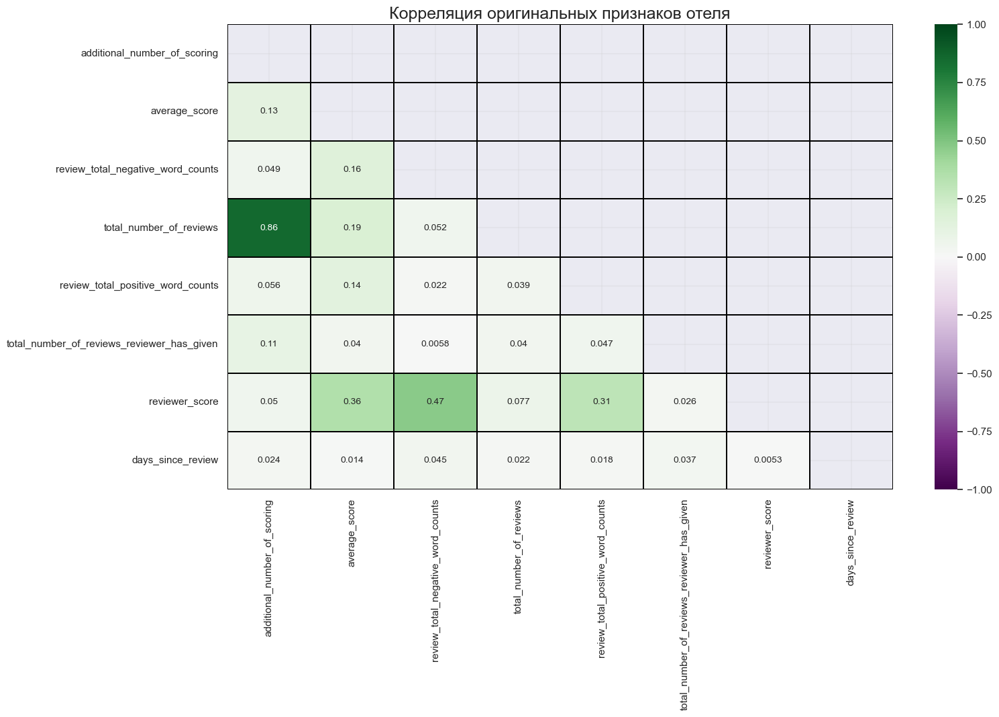

In [320]:
#строим диаграмму для оригинальных признаков характеристик отеля:
original_hotel = ['additional_number_of_scoring', 'average_score',
            'review_total_negative_word_counts', 'total_number_of_reviews',
            'review_total_positive_word_counts',
            'total_number_of_reviews_reviewer_has_given', 'reviewer_score',
            'days_since_review']

corr_heatmap(original_hotel, 'Корреляция оригинальных признаков отеля');

<hr style="border-style: dashed;">

<span style="color:#D2691E">

Как видим м/д параметрами в основном слабая связь либо отсутствующая, есть сильная связь м/д 
total_number_of_reviews и additional_number_of_scoring.
    
<hr style="border-style: dashed;">

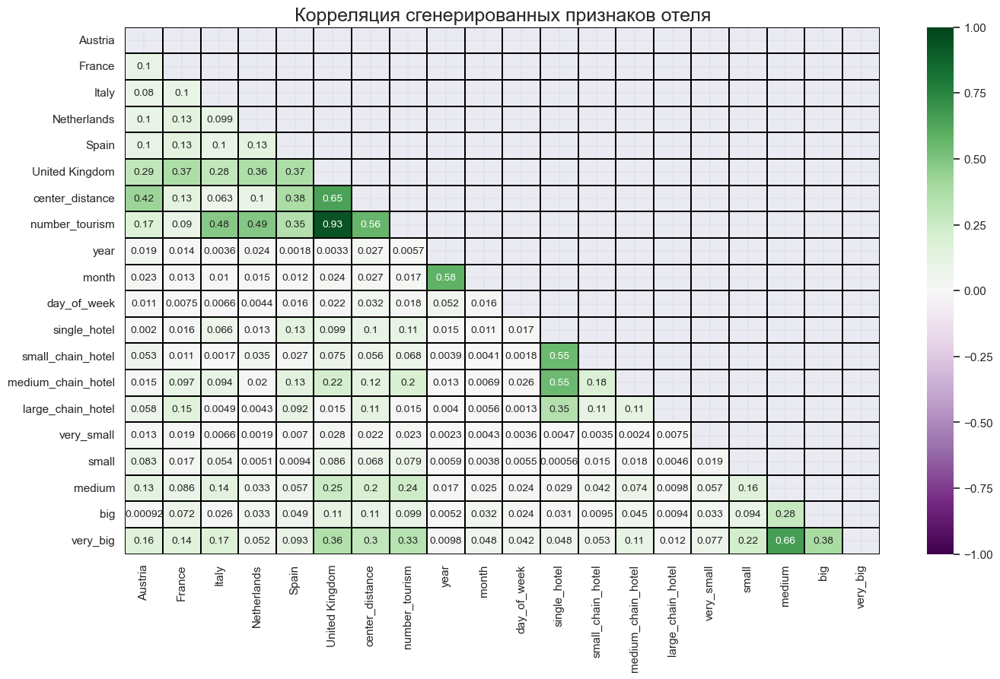

In [321]:
#строим диаграмму для сгенерированные признаки характеристики отеля:
generate_hotel = ['Austria', 'France', 'Italy', 'Netherlands',  'Spain', 
            'United Kingdom', 'center_distance', 'number_tourism', 'year', 
            'month', 'day_of_week', 'single_hotel', 'small_chain_hotel',  
            'medium_chain_hotel', 'large_chain_hotel', 'very_small', 'small', 
            'medium', 'big', 'very_big']

corr_heatmap(generate_hotel, 'Корреляция сгенерированных признаков отеля');

<hr style="border-style: dashed;">

<span style="color:#D2691E">

Здесь мы видим больше разнообразие м/д связей. Очень сильная связь наблюдается м/д количеством достопримечательностей (number_tourism) и United Kingdom - возможно это последствие того, что большинство оценок приходится на Лондон. Остальные связи выделяюшиеся у нас средней силы. Возможно придеться удалить, какой то из 
сильноскоррелированных признаков.
    
<hr style="border-style: dashed;">

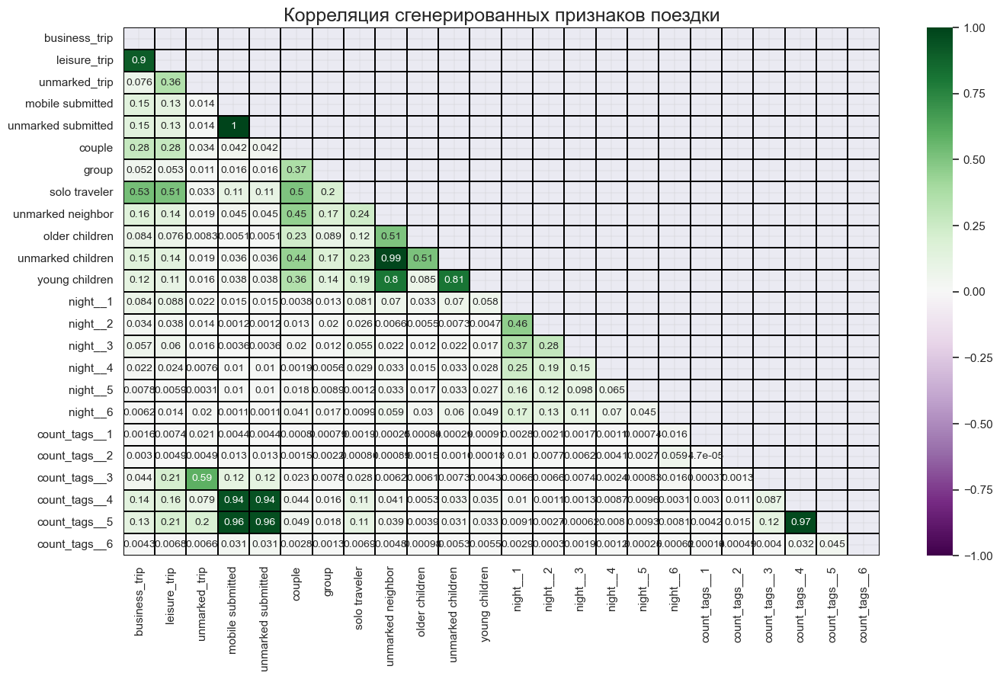

In [322]:
generate_trip = ['business_trip', 'leisure_trip', 'unmarked_trip', 
                 'mobile submitted', 'unmarked submitted', 'couple', 'group', 
                 'solo traveler', 'unmarked neighbor', 'older children',  
                 'unmarked children', 'young children', 'night__1', 'night__2',
                 'night__3', 'night__4', 'night__5', 'night__6', 'count_tags__1',  
                 'count_tags__2', 'count_tags__3', 'count_tags__4', 
                 'count_tags__5',  'count_tags__6']

corr_heatmap(generate_trip, 'Корреляция сгенерированных признаков поездки');

<hr style="border-style: dashed;">

<span style="color:#D2691E">

Здесь сразу видим 8 пар параметров с очень сильной связью. Возможно придеться их удалить. Посмотрим после построения модели.
    
<hr style="border-style: dashed;">

По итогам анализа, было принято решение удалить следующие коррелирующие параметры - 'leisure_trip', 'mobile submitted', 'unmarked submitted', 'unmarked neighbor', 'count_tags__5', 

<hr style="border-style: dashed;">

In [384]:
# удалим следующие параметры
corr_pozitiv = ['leisure_trip', 'mobile submitted', 'unmarked submitted', 
                'unmarked neighbor', 'count_tags__5']

hotels.drop(corr_pozitiv, axis=1, inplace=True)
df_test.drop(corr_pozitiv, axis=1, inplace=True)
display(hotels)
display(df_test)

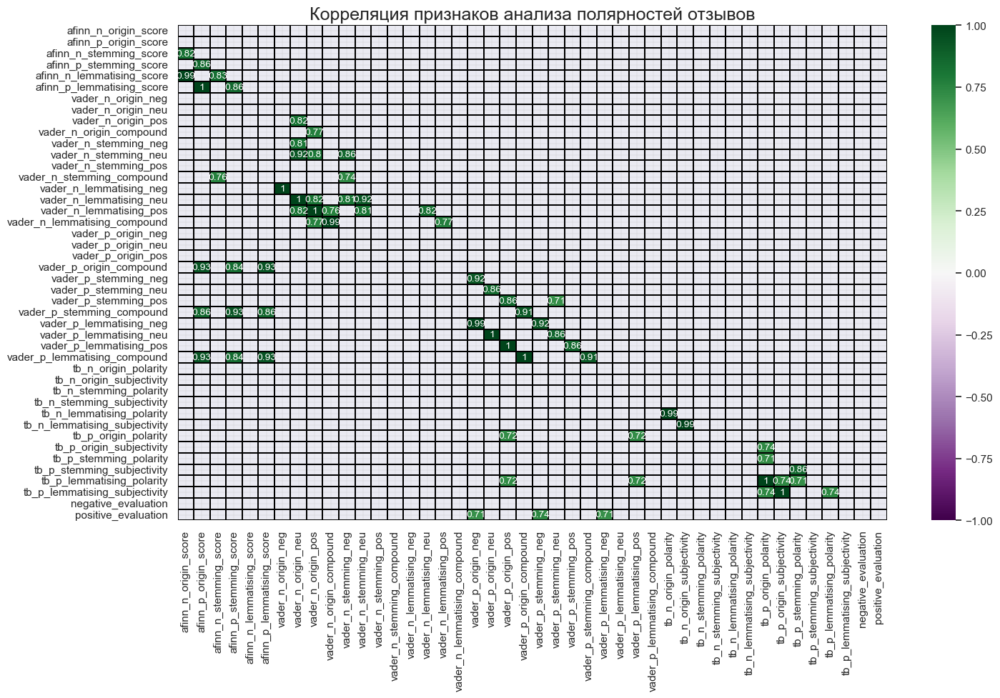

In [324]:
polarity =  ['afinn_n_origin_score',  'afinn_p_origin_score', 'afinn_n_stemming_score', 
               'afinn_p_stemming_score', 'afinn_n_lemmatising_score',
               'afinn_p_lemmatising_score', 'vader_n_origin_neg', 
               'vader_n_origin_neu',  'vader_n_origin_pos', 
               'vader_n_origin_compound', 'vader_n_stemming_neg',
               'vader_n_stemming_neu', 'vader_n_stemming_pos',
               'vader_n_stemming_compound', 'vader_n_lemmatising_neg', 
               'vader_n_lemmatising_neu', 'vader_n_lemmatising_pos',
               'vader_n_lemmatising_compound', 'vader_p_origin_neg',
               'vader_p_origin_neu', 'vader_p_origin_pos', 'vader_p_origin_compound',
               'vader_p_stemming_neg', 'vader_p_stemming_neu', 'vader_p_stemming_pos', 
               'vader_p_stemming_compound', 'vader_p_lemmatising_neg',  
               'vader_p_lemmatising_neu', 'vader_p_lemmatising_pos',  
               'vader_p_lemmatising_compound', 'tb_n_origin_polarity',
               'tb_n_origin_subjectivity', 'tb_n_stemming_polarity',
               'tb_n_stemming_subjectivity', 'tb_n_lemmatising_polarity',
               'tb_n_lemmatising_subjectivity', 'tb_p_origin_polarity',
             'tb_p_origin_subjectivity', 'tb_p_stemming_polarity',
             'tb_p_stemming_subjectivity', 'tb_p_lemmatising_polarity',
             'tb_p_lemmatising_subjectivity', 'negative_evaluation', 'positive_evaluation']

corr_heatmap(polarity, 'Корреляция признаков анализа полярностей отзывов', corr_scoping=0.7);

<hr style="border-style: dashed;">

<span style="color:#D2691E">
    
Здесь мы видим большое число признаков, которые очень сильно коррелируют м/д собой, но в дальнейшем это окажется только на руку модели, так как благодаря этому она сможет с большей точностью предсказывать рейтинг. У меня были попытки удалить именно оценки полярности коррелирующиеся, но результат был хуже.    

<hr style="border-style: dashed;">

## <center> 4. Обучение модели и получение реузльтатов 


In [400]:
# размерность датафрейма
display(hotels.shape)
display(df_test.shape)

(386803, 91)

(386803, 90)

In [385]:
# Разбиваем датафрейм на части, необходимые для обучения и тестирования модели  
# Х - данные с информацией об отелях, у - целевая переменная (рейтинги отелей)  
X = hotels.drop(['reviewer_score'], axis = 1)  
y = hotels['reviewer_score'] 

In [386]:
# Наборы данных с меткой "train" будут использоваться для обучения модели, "test" - для тестирования.  
# Для тестирования мы будем использовать 25% от исходного датасета.  
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

In [387]:
# Создаём модель и задаем параметры
regr = RandomForestRegressor(n_estimators=100, 
                             verbose=1, 
                             n_jobs=-1, 
                             random_state=RANDOM_SEED
                            )  
      
# Обучаем модель на тестовом наборе данных  
regr.fit(X_train, y_train)  
      
# Используем обученную модель для предсказания рейтинга отелей в тестовой выборке.  
# Предсказанные значения записываем в переменную y_pred  
y_pred = regr.predict(X_test);

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:  1.8min
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  4.8min finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.7s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    1.7s finished


In [388]:
# Сравниваем предсказанные значения (y_pred) с реальными (y_test), и смотрим насколько они отличаются  
# Метрика называется Mean Absolute Percentage Error (MAPE) и показывает 
# среднюю абсолютную процентную ошибку предсказанных значений от фактических.  
print('MAPE:', round(metrics.mean_absolute_percentage_error(y_test, y_pred) * 100, 4))

MAPE: 12.2066


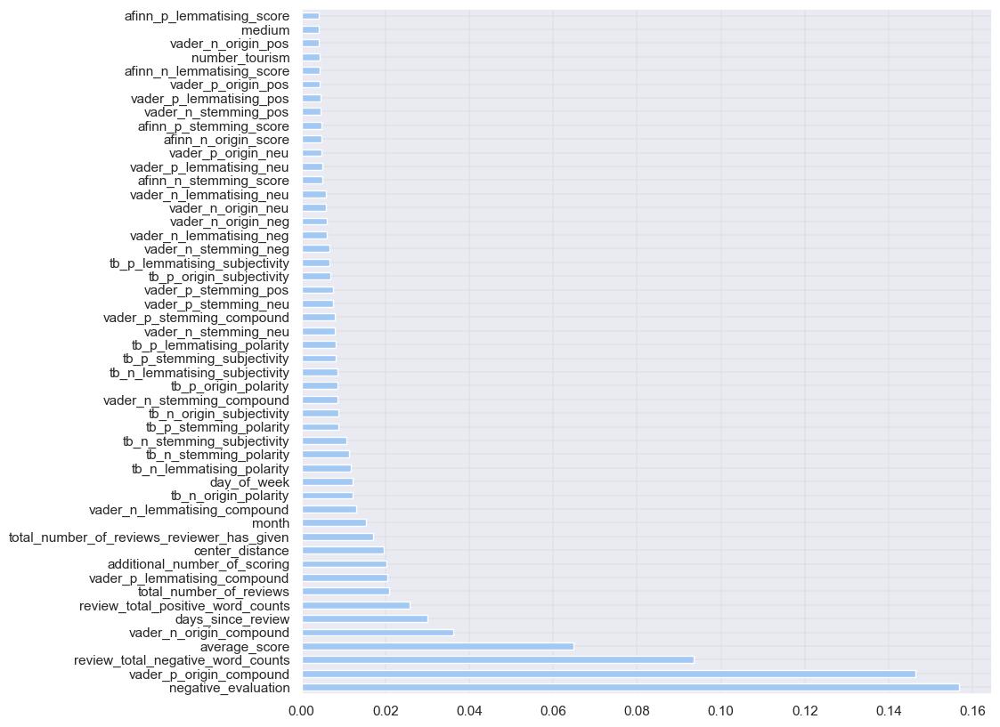

In [391]:
# в RandomForestRegressor есть возможность вывести самые важные признаки для модели
plt.rcParams['figure.figsize'] = (10,10)
feat_importances = pd.Series(regr.feature_importances_, index=X.columns)
feat_importances.nlargest(50).plot(kind='barh');

In [403]:
# получим предсказание на тестовом датафрейме
predict_submission = regr.predict(df_test)
# запишем данные
sample_submission['reviewer_score'] = predict_submission

[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    1.8s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    4.6s finished


ValueError: Length of values (386803) does not match length of index (128935)

In [407]:
predict_submission.min()

2.639

In [ ]:
#sample_submission['reviewer_score'] = sample_submission['reviewer_score'].apply(lambda x : round(x,1))
#  сохраняем результат:
sample_submission.to_csv('finalsubmission.csv', index=False)